In [1]:
#@title Import required library
from IPython.display import clear_output
import pandas as pd
import numpy as np
import scipy.stats as stats
import matplotlib.pyplot as plt
import yfinance
from tqdm import tqdm
from backtesting import Backtest, Strategy
from lib import crossover, cross, plot_heatmaps
import talib as ta
from strategy import *
from util import *
from c_strategy import *
from ipywidgets import widgets
from bokeh.io import output_notebook
from matplotlib import colors
clear_output()

In [2]:
strategy = CombiningStrategy
ticker = "BTC"
start_date = '2015/01/01 00:00:00'
end_date = '2022/09/05 00:00:00'
data = get_ohlcv_glassnode_api(ticker,resolution='1h',start=start_date,end=end_date,API_KEY='2DTcBg9x0YgVPwieR9fybZAlGoA')

In [3]:
bt = Backtest(data, strategy, exclusive_orders=False,cash=1000000)
bt.run(strategy_list = [(SMA_Cross,dict(fastperiod=15,slowperiod=20)),
                        (EMA_Cross,dict(fastperiod=15,slowperiod=20)),
                        (WMA_Cross,dict(fastperiod=15,slowperiod=20)),
                        (DEMA_Cross,dict(fastperiod=15,slowperiod=20))],
       condition = 'any')



Start                               2014-12-31 17:00:00
End                                 2022-09-04 16:00:00
Duration                             2803 days 23:00:00
Exposure Time [%]                             99.939025
Equity Final [$]                        108170266.38895
Equity Peak [$]                        153090142.907799
Return [%]                                 10717.026639
Log Return                                     4.683707
Buy & Hold Return [%]                       6191.995265
Buy & Hold Log Return                          4.141863
DCA Return [%]                              1641.044057
Return (Ann.) [%]                             83.944936
Volatility (Ann.) [%]                        260.164681
Sharpe Ratio                                   0.322661
Sortino Ratio                                  1.863764
Calmar Ratio                                   1.420337
Max. Drawdown [%]                            -59.102127
Avg. Drawdown [%]                             -3

In [4]:
bt = Backtest(data, strategy, exclusive_orders=False,cash=1000000)
bt.run(strategy_list = [(BolingerBands,dict())],
       condition = 'any')



Start                               2014-12-31 17:00:00
End                                 2022-09-04 16:00:00
Duration                             2803 days 23:00:00
Exposure Time [%]                             64.549903
Equity Final [$]                            4765.160292
Equity Peak [$]                          1002733.510367
Return [%]                                   -99.523484
Log Return                                    -5.346424
Buy & Hold Return [%]                       6191.995265
Buy & Hold Log Return                          4.141863
DCA Return [%]                              1641.044057
Return (Ann.) [%]                             -50.12759
Volatility (Ann.) [%]                         70.590861
Sharpe Ratio                                        0.0
Sortino Ratio                                       0.0
Calmar Ratio                                        0.0
Max. Drawdown [%]                            -99.554562
Avg. Drawdown [%]                             -2

In [6]:
bt.plot(filename='output',forintnode=True)
clear_output()
output_notebook()

Loading BokehJS ...

In [7]:
bt._results

Start                               2014-12-31 17:00:00
End                                 2022-09-04 16:00:00
Duration                             2803 days 23:00:00
Exposure Time [%]                             99.939025
Equity Final [$]                        108170266.38895
Equity Peak [$]                        153090142.907799
Return [%]                                 10717.026639
Log Return                                     4.683707
Buy & Hold Return [%]                       6191.995265
Buy & Hold Log Return                          4.141863
DCA Return [%]                              1641.044057
Return (Ann.) [%]                             83.944936
Volatility (Ann.) [%]                        260.164681
Sharpe Ratio                                   0.322661
Sortino Ratio                                  1.863764
Calmar Ratio                                   1.420337
Max. Drawdown [%]                            -59.102127
Avg. Drawdown [%]                             -3

In [5]:
win = bt._results._trades.query('PnL>0').shape[0]
lose = bt._results._trades.query('PnL<0').shape[0]

In [6]:
stats.binomtest(win,win+lose,p=0.5,alternative='greater')

BinomTestResult(k=96, n=212, alternative='greater', proportion_estimate=0.4528301886792453, pvalue=0.9254753035057584)

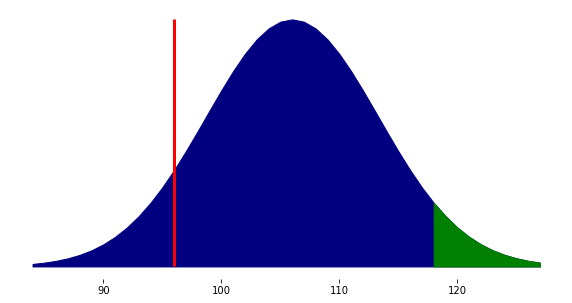

In [9]:
n, p = win+lose, 0.5
alpha = 0.05
x1 = np.arange(stats.binom.ppf(0.001, n, p),
              stats.binom.ppf(0.999, n, p))
x2 = np.arange(stats.binom.ppf(1-alpha, n, p),
              stats.binom.ppf(0.999, n, p))
rv = stats.binom(n,p)
fig = plt.figure(figsize=(10,5))
ax = fig.gca()
#ax.bar(x1,height=rv.pmf(x1),width=0.9,color='navy')
#ax.bar(x2,height=rv.pmf(x2),width=0.9,color='green')
ax.fill_between(x1,rv.pmf(x1),color='navy')
ax.fill_between(x2,rv.pmf(x2),color='green')
ax.get_yaxis().set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.vlines(x=win,ymin=0,ymax=rv.pmf(x1).max(),linewidth=3,colors='red')
plt.show()

In [13]:
rv.ppf(1-alpha)

118.0

In [10]:
rv.pmf(x2)

array([0.01411888, 0.01115273, 0.00864337, 0.00657182, 0.00490193,
       0.00358678, 0.00257438, 0.00181236, 0.00125139, 0.0008474 ])

In [5]:
import statsmodels.api as sm
c = data['Close']
equity = bt._results._equity_curve['Equity'].values
cut_c = c[np.arange(0,len(c),30)]
cut_e = equity[np.arange(0,len(c),30)]
strategy_return = [(cut_e[i]-cut_e[i-1])/cut_e[i-1]*100 for i in range(1,len(cut_e))]
market_return = [(cut_c[i]-cut_c[i-1])/cut_c[i-1]*100 for i in range(1,len(cut_c))]
Y = strategy_return
X = market_return

X_ = sm.add_constant(X)
reg = sm.OLS(Y,X_)
reg_result = reg.fit()
alpha_hat, beta_hat = reg_result.params
conf_alpha_hat, conf_beta_hat = reg_result.conf_int()
p_alpha_hat, p_beta_hat = reg_result.pvalues
t_alpha_hat, t_beta_hat = reg_result.tvalues
se_alpha_hat, se_beta_hat = reg_result.bse
reg_result.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.005
Model:                            OLS   Adj. R-squared:                  0.004
Method:                 Least Squares   F-statistic:                     10.53
Date:                Fri, 23 Sep 2022   Prob (F-statistic):            0.00119
Time:                        15:45:42   Log-Likelihood:                -5802.5
No. Observations:                2241   AIC:                         1.161e+04
Df Residuals:                    2239   BIC:                         1.162e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.1983      0.068     -2.906      0.004      -0.332      -0.064
x1             0.0502      0.015      3.245      0.001       0.020       0.080
==============================================================================
Omnibus:                      808.899   Durbin-Watson:                   2.172
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            15797.525
Skew:                          -1.206   Prob(JB):                         0.00
Kurtosis:                      15.782   Cond. No.                         4.43
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [6]:
alpha = 0.01
t_alpha_hat > stats.t(len(X)-1).ppf(1-alpha)

False

In [8]:
t_alpha_hat

-2.9056737306397133

In [9]:
stats.t.sf(abs(t_alpha_hat), df=len(X)-1)*2

0.0037005837742740307

In [38]:
stats.t(91).pdf(t_alpha_hat)

0.034077021597818405

In [23]:
alpha_hat/se_alpha_hat

2.2346520803939325

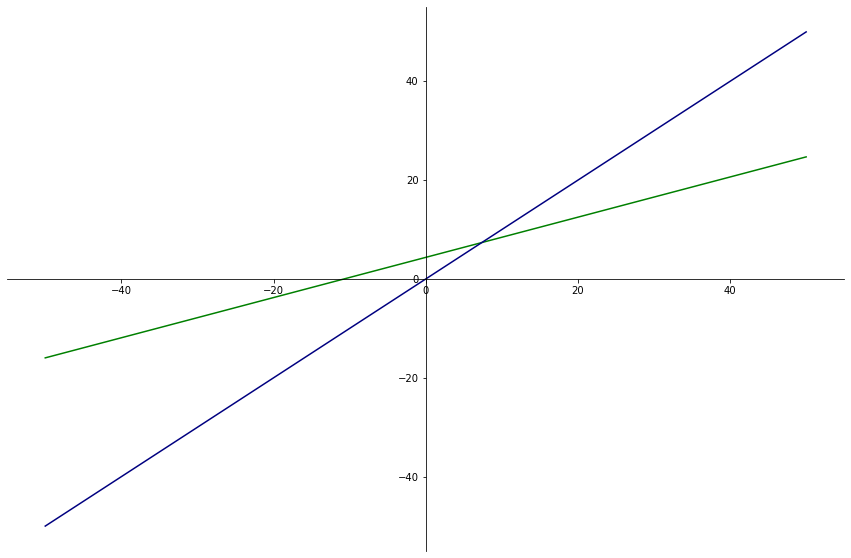

In [20]:
fig = plt.figure(figsize=(15,10))
x = np.linspace(-50,50)
ax = fig.gca()
#plt.scatter(X,Y)
ax.spines['left'].set_position('center')
ax.spines['bottom'].set_position('center')

# Eliminate upper and right axes
ax.spines['right'].set_color('none')
ax.spines['top'].set_color('none')

# Show ticks in the left and lower axes only
ax.xaxis.set_ticks_position('bottom')
ax.yaxis.set_ticks_position('left')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.plot(x,alpha_hat+beta_hat*x,color='green')
#ax.fill_between(x,alpha_hat+beta_hat*x,color='green')
ax.plot(x,x,color='navy')
plt.show()

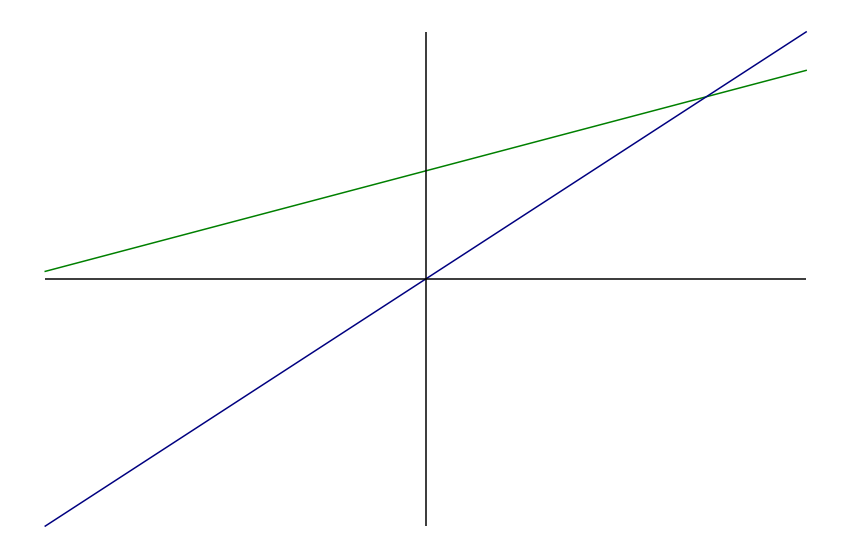

In [185]:
fig = plt.figure(figsize=(15,10))
x = np.linspace(-10,10)
ax = fig.gca()
#plt.scatter(X,Y)
ax.get_yaxis().set_visible(False)
ax.get_xaxis().set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.plot(x,alpha_hat+beta_hat*x,color='green')
#ax.fill_between(x,alpha_hat+beta_hat*x,color='green')
ax.plot(x,x,color='navy')
ax.hlines(y=0,xmin=-10,xmax=10,color='black')
ax.vlines(x=0,ymin=-10,ymax=10,color='black')
plt.show()

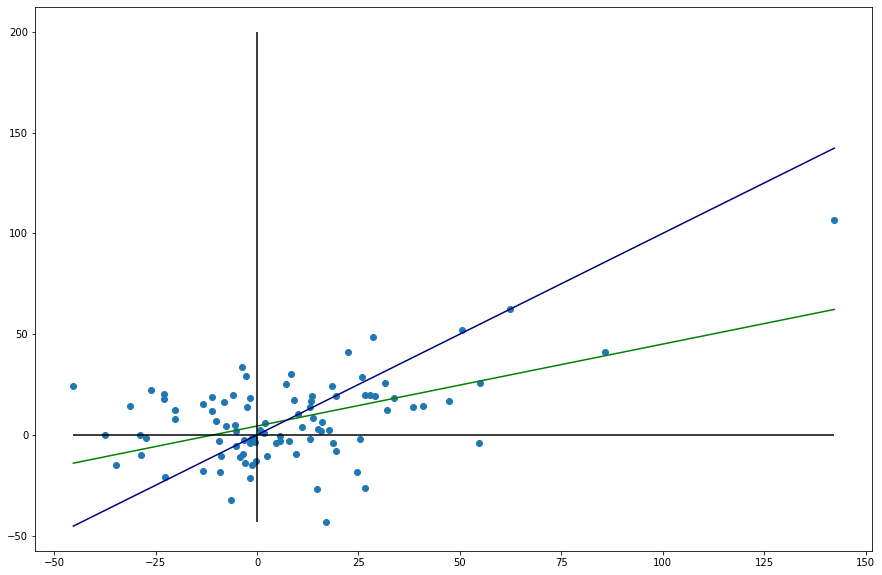

In [176]:
plt.figure(figsize=(15,10))
x = np.linspace(min(X),max(X))
plt.scatter(X,Y)
plt.plot(x,alpha_hat+beta_hat*x,color='green')
plt.plot(x,x,color='navy')
plt.hlines(y=0,xmin=min(X),xmax=max(X),color='black')
plt.vlines(x=0,ymin=min(Y),ymax=200,color='black')

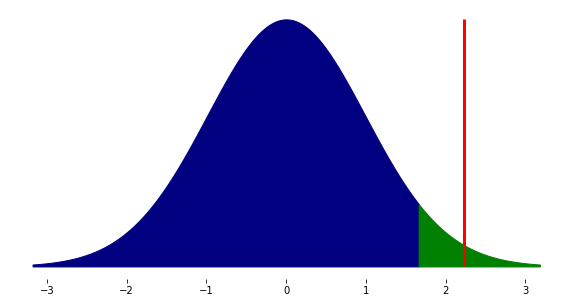

In [141]:
df = len(X)-1
alpha = 0.05
x1 = np.linspace(stats.t.ppf(0.001, df),
                stats.t.ppf(1-alpha, df), 500)
x2 = np.linspace(stats.t.ppf(1-alpha, df),
                stats.t.ppf(0.999, df), 500)
rv = stats.t(df)
fig = plt.figure(figsize=(10,5))
ax = fig.gca()
#ax.plot(x, rv.pdf(x),'r-', lw=1, alpha=1, label='t pdf')
ax.get_yaxis().set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.vlines(x=t_alpha_hat,ymin=0,ymax=rv.pdf(x).max(),linewidth=3,colors='red')
ax.fill_between(x1,rv.pdf(x1),color='navy')
ax.fill_between(x2,rv.pdf(x2),color='green')
plt.show()

In [126]:
rv.cdf(1)

0.8400332677663128

In [114]:
p_alpha_hat

0.027888432398240282

In [107]:
x

array([-2.36711519, -2.31929468, -2.27147418, -2.22365367, -2.17583316,
       -2.12801265, -2.08019214, -2.03237163, -1.98455112, -1.93673061,
       -1.8889101 , -1.84108959, -1.79326909, -1.74544858, -1.69762807,
       -1.64980756, -1.60198705, -1.55416654, -1.50634603, -1.45852552,
       -1.41070501, -1.36288451, -1.315064  , -1.26724349, -1.21942298,
       -1.17160247, -1.12378196, -1.07596145, -1.02814094, -0.98032043,
       -0.93249992, -0.88467942, -0.83685891, -0.7890384 , -0.74121789,
       -0.69339738, -0.64557687, -0.59775636, -0.54993585, -0.50211534,
       -0.45429484, -0.40647433, -0.35865382, -0.31083331, -0.2630128 ,
       -0.21519229, -0.16737178, -0.11955127, -0.07173076, -0.02391025,
        0.02391025,  0.07173076,  0.11955127,  0.16737178,  0.21519229,
        0.2630128 ,  0.31083331,  0.35865382,  0.40647433,  0.45429484,
        0.50211534,  0.54993585,  0.59775636,  0.64557687,  0.69339738,
        0.74121789,  0.7890384 ,  0.83685891,  0.88467942,  0.93

In [104]:
x1

array([-3.18019056, -2.18019056, -1.18019056, -0.18019056,  0.81980944])

In [84]:
rv.pmf(105)

0.05422281754344191

In [ ]:
strategy = CombiningStrategy
ticker = "BTC"
start_date = '2010/01/01 00:00:00'
end_date = '2022/09/05 00:00:00'
data = get_ohlcv_glassnode_api(ticker,resolution='24h',start=start_date,end=end_date,API_KEY='2DTcBg9x0YgVPwieR9fybZAlGoA')

In [ ]:
bt = Backtest(data, strategy, exclusive_orders=False,cash=1000000)
bt.run(strategy_list = [(EMA_Cross,dict(fastperiod=25,slowperiod=60))],
       condition = 'any')
bt.plot()
output_notebook()
bt._results

Loading BokehJS ...

Start                         2010-07-17 00:00:00
End                           2022-09-03 00:00:00
Duration                       4431 days 00:00:00
Exposure Time [%]                       98.104693
Equity Final [$]              12994392574134.5...
Equity Peak [$]               13196822914470.3...
Return [%]                      1299439157.413454
Log Return                              16.380028
Buy & Hold Return [%]              40022217.79663
Buy & Hold Log Return                   12.899778
DCA Return [%]                      933983.662546
Return (Ann.) [%]                      285.351995
Volatility (Ann.) [%]                  544.989933
Sharpe Ratio                             0.523591
Sortino Ratio                            5.353187
Calmar Ratio                             4.054701
Max. Drawdown [%]                      -70.375595
Avg. Drawdown [%]                      -11.518258
Max. Drawdown Duration          737 days 00:00:00
Avg. Drawdown Duration           38 days 00:00:00


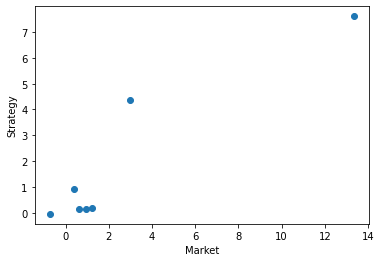

0.5683946197464884 0.37539487359624757
1.7889128047402787 428.1781455505998
0.03823250611503014 0.0008767259083564913
0.37367649081586884 0.3771132563766263


In [9]:
equity = bt._results._equity_curve
equity['Close'] = data['Close']
equity = equity.iloc[np.arange(1,len(equity),365)]
equity['CloseT1'] = [np.nan]+list(equity['Close'].values[:-1])
equity['EquityT1'] = [np.nan]+list(equity['Equity'].iloc[:-1].values)
equity['Strategy'] = (equity['Equity']-equity['EquityT1'])/equity['EquityT1']
equity['BuyHold'] = (equity['EquityT1']/equity['CloseT1']*equity['Close']-equity['EquityT1'])/equity['EquityT1']
clear_output()
Y = equity['Strategy'].values[1:]
X = equity['BuyHold'].values[1:]
plt.scatter(X,Y)
plt.xlabel('Market')
plt.ylabel("Strategy")
plt.show()
from sklearn.linear_model import LinearRegression
reg = LinearRegression()
reg.fit(X.reshape(-1, 1),Y)
alpha = reg.coef_[0]
beta = reg.intercept_
u = Y-(alpha*X+beta)
n = len(X)
SE_alpha = np.sqrt(1/n*(1/(n-2)*np.sum((X-np.mean(X))**2*u**2)/(1/n*np.sum((X-np.mean(X))**2))**2))
SE_beta = np.sqrt(1/n*(1/(n-2)*np.sum((1-(np.mean(X)/(1/n)*np.sum(X**2)))**2*u**2)/((1/n)*np.sum((1-(np.mean(X)/(1/n)*np.sum(X**2)))**2))**2))
t_beta = (beta-0)/SE_beta
t_alpha = (alpha-0.5)/SE_alpha
print(alpha,beta)
print(t_alpha,t_beta)
print(SE_alpha,SE_beta)
print(beta-1.96*SE_beta,beta+1.96*SE_beta)

In [ ]:
u

array([ 0.04021622,  0.40815136, -0.4792676 , -1.41675407,  0.20705197,
       -1.71100743, -0.89793139,  2.38543162,  0.29263041, -0.65255914,
        1.90504323, -0.08100519])

In [ ]:
equity

,Equity,DrawdownPct,DrawdownDuration,Close,CloseT1,EquityT1,Strategy,BuyHold
2010-07-17,1.000000e+06,0.000000,NaT,0.049510,NaN,NaN,NaN,NaN
2010-07-18,1.000000e+06,0.000000,NaT,0.085840,0.049510,1.000000e+06,0.000000,0.733791
2010-07-19,1.000000e+06,0.000000,NaT,0.080800,0.085840,1.000000e+06,0.000000,-0.058714
2010-07-20,1.000000e+06,0.000000,NaT,0.074733,0.080800,1.000000e+06,0.000000,-0.075083
2010-07-21,1.000000e+06,0.000000,NaT,0.079210,0.074733,1.000000e+06,0.000000,0.059902
...,...,...,...,...,...,...,...,...
2022-08-30,1.303270e+13,0.012436,NaT,19790.327949,20284.900681,1.292708e+13,0.008170,-0.024381
2022-08-31,1.297853e+13,0.016542,NaT,20044.007643,19790.327949,1.303270e+13,-0.004157,0.012818
2022-09-01,1.296349e+13,0.017681,NaT,20114.411404,20044.007643,1.297853e+13,-0.001158,0.003512
2022-09-02,1.299947e+13,0.014955,NaT,19945.951742,20114.411404,1.296349e+13,0.002775,-0.008375


(array([ 1.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  1.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         1.,  0.,  0.,  0.,  0.,  0.,  0.,  1.,  0.,  0.,  0.,  1.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  1.,  0.,  0.,  0.,  0.,
         1.,  0.,  0.,  0.,  0.,  0.,  1.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  1.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  1.,  1.,  0.

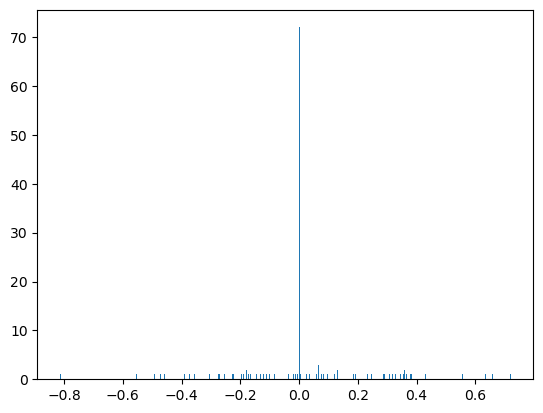

In [ ]:
plt.hist(Y-X,bins=500)

In [ ]:
from sklearn.linear_model import LinearRegression

reg = LinearRegression()
reg.fit(X.reshape(-1, 1),Y)
alpha = reg.coef_[0]
beta = reg.intercept_
u = Y-(alpha*X+beta)
n = len(X)
SE_alpha = np.sqrt(1/n*(1/(n-2)*np.sum((X-np.mean(X))**2*u**2)/(1/n*np.sum((X-np.mean(X))**2))**2))
SE_beta = np.sqrt(1/n*(1/(n-2)*np.sum((1-(np.mean(X)/(1/n)*np.sum(X**2)))**2*u**2)/((1/n)*np.sum((1-(np.mean(X)/(1/n)*np.sum(X**2)))**2))**2))
t_beta = (beta-0)/SE_beta
t_alpha = (alpha-0)/SE_alpha
print(t_alpha,t_beta)
print(beta-1.96*SE_beta,beta+1.96*SE_beta)

4.368619190766841 1.035496137072655
-0.0431873952886889 0.1399320013091867


In [ ]:
trade_table = bt._results._trades
trade_table['ReturnPct'] = trade_table['ReturnPct']*100
trade_table['Log PnL'] = np.log((trade_table['ExitPrice']/trade_table['EntryPrice'])**np.sign(trade_table['Size']))
trade_table

,Size,EntryBar,ExitBar,EntryPrice,ExitPrice,PnL,ReturnPct,EntryTime,ExitTime,Duration,Log PnL
0,4518,41,78,221.299787,257.836440,1.650726e+05,16.510026,2015-02-10,2015-03-19,37 days,0.152807
1,-4518,78,100,257.836440,244.216829,6.153340e+04,5.282267,2015-03-19,2015-04-10,22 days,0.054269
2,5022,100,101,244.216829,236.326733,-3.962406e+04,-3.230775,2015-04-10,2015-04-11,1 days,-0.032841
3,-5022,101,114,236.326733,235.634702,3.475380e+03,0.292828,2015-04-11,2015-04-24,13 days,0.002933
4,5052,114,140,235.634702,232.079998,-1.795836e+04,-1.508566,2015-04-24,2015-05-20,26 days,-0.015201
...,...,...,...,...,...,...,...,...,...,...,...
207,-6378,2747,2748,21716.828585,21592.206074,7.948424e+05,0.573852,2022-07-09,2022-07-10,1 days,0.005755
208,6451,2748,2776,21592.206074,22969.268873,8.883432e+06,6.377592,2022-07-10,2022-08-07,28 days,0.061825
209,-6451,2776,2778,22969.268873,23819.638789,-5.485736e+06,-3.702207,2022-08-07,2022-08-09,2 days,-0.036353
210,5991,2778,2788,23819.638789,23213.313242,-3.632496e+06,-2.545486,2022-08-09,2022-08-19,10 days,-0.025784


In [ ]:
avg_win_PcT = trade_table.query('ReturnPct>0')['ReturnPct'].mean()
win_count = len(trade_table.query('ReturnPct>0'))
avg_lose_PcT = trade_table.query('ReturnPct<0')['ReturnPct'].mean()
lose_count = len(trade_table.query('ReturnPct<0'))
avg_PcT = trade_table['ReturnPct'].mean()
count = len(trade_table)

In [ ]:
from bokeh.plotting import figure, output_file, show
from bokeh.models import ColumnDataSource, Span
from bokeh.palettes import Spectral3
from bokeh.layouts import gridplot

p1 = figure(plot_width=800, plot_height=400,x_axis_label='# Trade',y_axis_label='ReturnPct%',
                              tooltips=[('ReturnPct%', '@ReturnPct%'),
                                        ('# Trade', '@index')])
values = trade_table['ReturnPct'].values
bins = [np.NINF, 0, np.inf]
categories = pd.cut(values, bins, right=False)
palette = ['tomato', 'lime']
colors = [palette[i] for i in categories.codes]
source1 = ColumnDataSource(data={'index' : trade_table.index, 'ReturnPct' : trade_table['ReturnPct'], 'color' : colors})
p1.vbar(x='index',top='ReturnPct',color='color',source=source1)

types = ['Avg. ReturnPct']
p2 = figure(plot_width=100, plot_height=400,x_range=types,y_range=p1.y_range,tooltips=[('Win','@win%'),
                                                                                       ('Lose','@lose%'),
                                                                                       ('All','@all%')])
win = [trade_table.query('ReturnPct>0')['ReturnPct'].mean()]
lose = [trade_table.query('ReturnPct<0')['ReturnPct'].mean()]
all = [trade_table['ReturnPct'].mean()]
source2 = ColumnDataSource(data={'types' : types, 'win' : win, 'lose' : lose, 'all': all})
p2.vbar('types', top='win',width=0.8,color='lime',source=source2)
p2.vbar('types', top='lose',width=0.8,color='tomato',source=source2)
p2.yaxis.visible = False

import scipy as sp
sample = trade_table['ReturnPct'].values
confidence_level = 0.95
degrees_freedom = sample.size - 1
sample_mean = np.mean(sample)
sample_standard_error = sp.stats.sem(sample)

confidence_interval = sp.stats.t.interval(confidence_level, degrees_freedom, sample_mean, sample_standard_error)
mean = Span(location=all[0], dimension='width', line_color='blue', line_width=1)
l_conf = Span(location=confidence_interval[0], dimension='width', line_color='blue', line_dash='dashed', line_width=1)
h_conf = Span(location=confidence_interval[1], dimension='width', line_color='blue', line_dash='dashed', line_width=1)
p1.renderers.extend([mean,l_conf,h_conf])
p2.renderers.extend([mean,l_conf,h_conf])
layout = gridplot([[p1,p2]])
show(layout)
output_notebook()

Loading BokehJS ...

In [ ]:
from bokeh.plotting import figure, output_file, show
from bokeh.models import ColumnDataSource, Span
from bokeh.palettes import Spectral3
from bokeh.layouts import gridplot

p1 = figure(plot_width=800, plot_height=400,x_axis_label='# Trade',y_axis_label='PnL $',
                              tooltips=[('PnL', '@PnL'),
                                        ('# Trade', '@index')])
values = trade_table['PnL'].values
bins = [np.NINF, 0, np.inf]
categories = pd.cut(values, bins, right=False)
palette = ['tomato', 'lime']
colors = [palette[i] for i in categories.codes]
source1 = ColumnDataSource(data={'index' : trade_table.index, 'PnL' : trade_table['PnL'], 'color' : colors})
p1.vbar(x='index',top='PnL',color='color',source=source1)

types = ['Avg. PnL']
p2 = figure(plot_width=100, plot_height=400,x_range=types,y_range=p1.y_range,tooltips=[('Win','@win'),
                                                                                       ('Lose','@lose'),
                                                                                       ('All','@all')])
win = [trade_table.query('PnL>0')['PnL'].mean()]
lose = [trade_table.query('PnL<0')['PnL'].mean()]
all = [trade_table['PnL'].mean()]
source2 = ColumnDataSource(data={'types' : types, 'win' : win, 'lose' : lose, 'all': all})
p2.vbar('types', top='win',width=0.8,color='lime',source=source2)
p2.vbar('types', top='lose',width=0.8,color='tomato',source=source2)
p2.yaxis.visible = False

import scipy as sp
sample = trade_table['PnL'].values
confidence_level = 0.95
degrees_freedom = sample.size - 1
sample_mean = np.mean(sample)
sample_standard_error = sp.stats.sem(sample)

confidence_interval = sp.stats.t.interval(confidence_level, degrees_freedom, sample_mean, sample_standard_error)
mean = Span(location=all[0], dimension='width', line_color='blue', line_width=1)
l_conf = Span(location=confidence_interval[0], dimension='width', line_color='blue', line_dash='dashed', line_width=1)
h_conf = Span(location=confidence_interval[1], dimension='width', line_color='blue', line_dash='dashed', line_width=1)
p1.renderers.extend([mean,l_conf,h_conf])
p2.renderers.extend([mean,l_conf,h_conf])
layout = gridplot([[p1,p2]])
show(layout)
output_notebook()

Loading BokehJS ...

In [ ]:
max_range = np.max([np.abs([trade_table['PnL'].min(),trade_table['PnL'].max()])])
arr_hist, edges = np.histogram(trade_table.query('PnL>0')['PnL'],bins=50,range=(0,max_range))
pos_hist = pd.DataFrame({'Count PnL': arr_hist, 
                       'left': edges[:-1], 
                       'right': edges[1:]})
arr_hist, edges = np.histogram(trade_table.query('PnL<0')['PnL'],bins=50,range=[-max_range,0])
neg_hist = pd.DataFrame({'Count PnL': arr_hist, 
                       'left': edges[:-1], 
                       'right': edges[1:]})
neg_hist['color'] = 'tomato'
pos_hist['color'] = 'lime'

hist = pd.concat([neg_hist,pos_hist],ignore_index=True)

p = figure(plot_height = 600, plot_width = 1000, 
           title = 'Histogram of PnL',
          x_axis_label = 'PnL return', 
           y_axis_label = 'Number of trades',
           tooltips=[('Count Trade', '@{Count PnL}'),
                     ('(left,right)', '(@left,@right)')])

# Add a quad glyph
p.quad(bottom=0, top='Count PnL', 
       left='left', right='right', 
       fill_color='color', line_color='black', source=hist)

import scipy as sp
sample = trade_table['PnL'].values
confidence_level = 0.95
degrees_freedom = sample.size - 1
sample_mean = np.mean(sample)
sample_standard_error = sp.stats.sem(sample)

confidence_interval = sp.stats.t.interval(confidence_level, degrees_freedom, sample_mean, sample_standard_error)
mean = Span(location=sample_mean, dimension='height', line_color='blue', line_width=2)
l_conf = Span(location=confidence_interval[0], dimension='height', line_color='blue', line_dash='dashed', line_width=1)
h_conf = Span(location=confidence_interval[1], dimension='height', line_color='blue', line_dash='dashed', line_width=1)
p.renderers.extend([mean,l_conf,h_conf])
# Show the plot
show(p)
output_notebook()

Loading BokehJS ...

In [ ]:
max_range = np.max([np.abs([trade_table['ReturnPct'].min(),trade_table['ReturnPct'].max()])])
arr_hist, edges = np.histogram(trade_table.query('ReturnPct>0')['ReturnPct'],bins=50,range=(0,max_range))
pos_hist = pd.DataFrame({'Count ReturnPct': arr_hist, 
                       'left': edges[:-1], 
                       'right': edges[1:]})
arr_hist, edges = np.histogram(trade_table.query('ReturnPct<0')['ReturnPct'],bins=50,range=[-max_range,0])
neg_hist = pd.DataFrame({'Count ReturnPct': arr_hist, 
                       'left': edges[:-1], 
                       'right': edges[1:]})
neg_hist['color'] = 'tomato'
pos_hist['color'] = 'lime'

hist = pd.concat([neg_hist,pos_hist],ignore_index=True)

p = figure(plot_height = 600, plot_width = 1000, 
           title = 'Histogram of ReturnPct',
          x_axis_label = 'ReturnPct%', 
           y_axis_label = 'Number of trades',
           tooltips=[('Count Trade', '@{Count ReturnPct}'),
                     ('(left,right)', '(@left,@right)')])

# Add a quad glyph
p.quad(bottom=0, top='Count ReturnPct', 
       left='left', right='right', 
       fill_color='color', line_color='black', source=hist)

import scipy as sp
sample = trade_table['ReturnPct'].values
confidence_level = 0.95
degrees_freedom = sample.size - 1
sample_mean = np.mean(sample)
sample_standard_error = sp.stats.sem(sample)

confidence_interval = sp.stats.t.interval(confidence_level, degrees_freedom, sample_mean, sample_standard_error)
mean = Span(location=sample_mean, dimension='height', line_color='blue', line_width=1.5)
l_conf = Span(location=confidence_interval[0], dimension='height', line_color='blue', line_dash='dashed', line_width=1)
h_conf = Span(location=confidence_interval[1], dimension='height', line_color='blue', line_dash='dashed', line_width=1)
p.renderers.extend([mean,l_conf,h_conf])
# Show the plot
show(p)
output_notebook()

Loading BokehJS ...

In [ ]:
bt = Backtest(data, strategy, exclusive_orders=False,cash=1000000)
bt.run(strategy_list = [(SMA_Cross,dict())],
       condition = 'any')
bt.plot()
output_notebook()
trade_table = bt._results._trades
trade_table['ReturnPct'] = trade_table['ReturnPct']*100

Loading BokehJS ...

In [ ]:
from bokeh.plotting import figure, output_file, show
from bokeh.models import ColumnDataSource, Span
from bokeh.palettes import Spectral3
from bokeh.layouts import gridplot

p1 = figure(plot_width=900, plot_height=400,x_axis_label='# Trade',y_axis_label='PnL $',
                              tooltips=[('PnL', '@PnL'),
                                        ('# Trade', '@index')])
values = trade_table['PnL'].values
bins = [np.NINF, 0, np.inf]
categories = pd.cut(values, bins, right=False)
palette = ['tomato', 'lime']
colors = [palette[i] for i in categories.codes]
source1 = ColumnDataSource(data={'index' : trade_table.index, 'PnL' : trade_table['PnL'], 'color' : colors})
p1.vbar(x='index',top='PnL',color='color',source=source1)

types = ['Avg. PnL']
p2 = figure(plot_width=100, plot_height=400,x_range=types,y_range=p1.y_range,tooltips=[('Win','@win'),
                                                                                       ('Lose','@lose'),
                                                                                       ('All','@all')])
win = [trade_table.query('PnL>0')['PnL'].mean()]
lose = [trade_table.query('PnL<0')['PnL'].mean()]
all = [trade_table['PnL'].mean()]
source2 = ColumnDataSource(data={'types' : types, 'win' : win, 'lose' : lose, 'all': all})
p2.vbar('types', top='win',width=0.8,color='lime',source=source2)
p2.vbar('types', top='lose',width=0.8,color='tomato',source=source2)
p2.yaxis.visible = False

import scipy as sp
sample = trade_table['PnL'].values
confidence_level = 0.95
degrees_freedom = sample.size - 1
sample_mean = np.mean(sample)
sample_standard_error = sp.stats.sem(sample)

confidence_interval = sp.stats.t.interval(confidence_level, degrees_freedom, sample_mean, sample_standard_error)
mean = Span(location=all[0], dimension='width', line_color='blue', line_width=1)
l_conf = Span(location=confidence_interval[0], dimension='width', line_color='blue', line_dash='dashed', line_width=1)
h_conf = Span(location=confidence_interval[1], dimension='width', line_color='blue', line_dash='dashed', line_width=1)
p1.renderers.extend([mean,l_conf,h_conf])
p2.renderers.extend([mean,l_conf,h_conf])

max_range = np.max([np.abs([trade_table['PnL'].min(),trade_table['PnL'].max()])])
arr_hist, edges = np.histogram(trade_table.query('PnL>0')['PnL'],bins=50,range=(0,max_range))
pos_hist = pd.DataFrame({'Count PnL': arr_hist, 
                       'left': edges[:-1], 
                       'right': edges[1:]})
arr_hist, edges = np.histogram(trade_table.query('PnL<0')['PnL'],bins=50,range=[-max_range,0])
neg_hist = pd.DataFrame({'Count PnL': arr_hist, 
                       'left': edges[:-1], 
                       'right': edges[1:]})
neg_hist['color'] = 'tomato'
pos_hist['color'] = 'lime'

hist = pd.concat([neg_hist,pos_hist],ignore_index=True)

p_hist = figure(plot_height = 600, plot_width = 1000, 
           title = 'Histogram of PnL',
          x_axis_label = 'PnL return', 
           y_axis_label = 'Number of trades',
           tooltips=[('Count Trade', '@{Count PnL}'),
                     ('(left,right)', '(@left,@right)')])

# Add a quad glyph
p_hist.quad(bottom=0, top='Count PnL', 
       left='left', right='right', 
       fill_color='color', line_color='black', source=hist)

import scipy as sp
sample = trade_table['PnL'].values
confidence_level = 0.95
degrees_freedom = sample.size - 1
sample_mean = np.mean(sample)
sample_standard_error = sp.stats.sem(sample)

confidence_interval = sp.stats.t.interval(confidence_level, degrees_freedom, sample_mean, sample_standard_error)
mean = Span(location=sample_mean, dimension='height', line_color='blue', line_width=2)
l_conf = Span(location=confidence_interval[0], dimension='height', line_color='blue', line_dash='dashed', line_width=1)
h_conf = Span(location=confidence_interval[1], dimension='height', line_color='blue', line_dash='dashed', line_width=1)
p_hist.renderers.extend([mean,l_conf,h_conf])

layout1 = gridplot([[p1,p2]],toolbar_location =None)
layout2 = gridplot([[layout1],[p_hist]])
show(layout2)
output_notebook()

Loading BokehJS ...

In [ ]:
from bokeh.plotting import figure, output_file, show
from bokeh.models import ColumnDataSource, Span
from bokeh.palettes import Spectral3
from bokeh.layouts import gridplot

p1 = figure(plot_width=1400, plot_height=400,x_axis_label='# Trade',y_axis_label='ReturnPct $',title="ReturnPct per trade",
                              tooltips=[('ReturnPct', '@ReturnPct'),
                                        ('# Trade', '@index')])
values = trade_table['ReturnPct'].values
bins = [np.NINF, 0, np.inf]
categories = pd.cut(values, bins, right=False)
palette = ['tomato', 'lime']
colors = [palette[i] for i in categories.codes]
source1 = ColumnDataSource(data={'index' : trade_table.index, 'ReturnPct' : trade_table['ReturnPct'], 'color' : colors})
p1.vbar(x='index',top='ReturnPct',fill_color='color', line_color='black',source=source1)

types = ['Avg. ReturnPct']
p2 = figure(plot_width=100, plot_height=400,x_range=types,y_range=p1.y_range,tooltips=[('Win','@win'),
                                                                                       ('Lose','@lose'),
                                                                                       ('All','@all')])
win = [trade_table.query('ReturnPct>0')['ReturnPct'].mean()]
lose = [trade_table.query('ReturnPct<0')['ReturnPct'].mean()]
all = [trade_table['ReturnPct'].mean()]
source2 = ColumnDataSource(data={'types' : types, 'win' : win, 'lose' : lose, 'all': all})
p2.vbar('types', top='win',width=0.8,fill_color='lime', line_color='black',source=source2)
p2.vbar('types', top='lose',width=0.8,fill_color='tomato', line_color='black',source=source2)
p2.yaxis.visible = False

import scipy as sp
sample = trade_table['ReturnPct'].values
confidence_level = 0.95
degrees_freedom = sample.size - 1
sample_mean = np.mean(sample)
sample_standard_error = sp.stats.sem(sample)

confidence_interval = sp.stats.t.interval(confidence_level, degrees_freedom, sample_mean, sample_standard_error)
mean = Span(location=all[0], dimension='width', line_color='blue', line_width=1)
l_conf = Span(location=confidence_interval[0], dimension='width', line_color='blue', line_dash='dashed', line_width=1)
h_conf = Span(location=confidence_interval[1], dimension='width', line_color='blue', line_dash='dashed', line_width=1)
p1.renderers.extend([mean,l_conf,h_conf])
p2.renderers.extend([mean,l_conf,h_conf])

max_range = np.max([np.abs([trade_table['ReturnPct'].min(),trade_table['ReturnPct'].max()])])
arr_hist, edges = np.histogram(trade_table.query('ReturnPct>0')['ReturnPct'],bins=50,range=(0,max_range))
pos_hist = pd.DataFrame({'Count ReturnPct': arr_hist, 
                       'left': edges[:-1], 
                       'right': edges[1:]})
arr_hist, edges = np.histogram(trade_table.query('ReturnPct<0')['ReturnPct'],bins=50,range=[-max_range,0])
neg_hist = pd.DataFrame({'Count ReturnPct': arr_hist, 
                       'left': edges[:-1], 
                       'right': edges[1:]})
neg_hist['color'] = 'tomato'
pos_hist['color'] = 'lime'

hist = pd.concat([neg_hist,pos_hist],ignore_index=True)

p_hist = figure(plot_height = 600, plot_width = 1000, 
           title = 'Histogram of ReturnPct',
          x_axis_label = 'ReturnPct', 
           y_axis_label = 'Number of trades',
           tooltips=[('Count Trade', '@{Count ReturnPct}'),
                     ('(left,right)', '(@left,@right)')])

# Add a quad glyph
p_hist.quad(bottom=0, top='Count ReturnPct', 
       left='left', right='right', 
       fill_color='color', line_color='black', source=hist)

import scipy as sp
sample = trade_table['ReturnPct'].values
confidence_level = 0.95
degrees_freedom = sample.size - 1
sample_mean = np.mean(sample)
sample_standard_error = sp.stats.sem(sample)

confidence_interval = sp.stats.t.interval(confidence_level, degrees_freedom, sample_mean, sample_standard_error)
mean = Span(location=sample_mean, dimension='height', line_color='blue', line_width=2)
l_conf = Span(location=confidence_interval[0], dimension='height', line_color='blue', line_dash='dashed', line_width=1)
h_conf = Span(location=confidence_interval[1], dimension='height', line_color='blue', line_dash='dashed', line_width=1)
p_hist.renderers.extend([mean,l_conf,h_conf])

from math import pi
from bokeh.palettes import Category20c
from bokeh.plotting import figure, show, output_file, save
from bokeh.transform import cumsum
from bokeh.models import LabelSet, ColumnDataSource

x = {
    'Win': len(trade_table.query('PnL>0')),
    'Lose': len(trade_table.query('PnL<0')),
    'Draw': len(trade_table.query('PnL==0'))
}

pie_data = pd.Series(x).reset_index(name='value').rename(columns={'index': 'situation'})
pie_data['angle'] = pie_data['value']/pie_data['value'].sum() * 2*pi
pie_data['color'] = ['lime','tomato','Gray']
pie_data['ratio'] = pie_data['value']/pie_data['value'].sum()

p_pie = figure(height=400,width=500, title="Win/Lose", toolbar_location=None,
           tools="hover", tooltips=[("","@situation : @value"),
                                    ("","@situation Rate : @ratio")], x_range=(-0.5, 1.0))

p_pie.wedge(x=0, y=1, radius=0.4,
        start_angle=cumsum('angle', include_zero=True), end_angle=cumsum('angle'),
        line_color="black", fill_color='color', legend_field='situation', source=pie_data)
p_pie.axis.axis_label=None
p_pie.axis.visible=False
p_pie.grid.grid_line_color = None

layout1 = gridplot([[p1,p2]],toolbar_location =None)
layout2 = gridplot([[p_hist,p_pie]],toolbar_location =None)
layout = gridplot([[layout1],[layout2]])
show(layout)
output_notebook()
output_file(filename="output.html", title="Static HTML file")

save(layout)

Loading BokehJS ...

'C:\\Users\\peema\\Documents\\GitHub\\backtesting.py_FL\\backtesting\\output.html'

In [ ]:
bt = Backtest(data, strategy, exclusive_orders=False,cash=1000000)
bt.run(strategy_list = [(BarUpDown,dict())],
       condition = 'any')
bt.plot()
output_notebook()
trade_table = bt._results._trades
trade_table['ReturnPct'] = trade_table['ReturnPct']*100

Loading BokehJS ...

In [ ]:
from bokeh.plotting import figure, output_file, show
from bokeh.models import ColumnDataSource, Span
from bokeh.palettes import Spectral3
from bokeh.layouts import gridplot

p1 = figure(plot_width=1400, plot_height=400,x_axis_label='# Trade',y_axis_label='ReturnPct $',title="ReturnPct per trade",
                              tooltips=[('ReturnPct', '@ReturnPct'),
                                        ('# Trade', '@index')])
values = trade_table['ReturnPct'].values
bins = [np.NINF, 0, np.inf]
categories = pd.cut(values, bins, right=False)
palette = ['tomato', 'lime']
colors = [palette[i] for i in categories.codes]
source1 = ColumnDataSource(data={'index' : trade_table.index, 'ReturnPct' : trade_table['ReturnPct'], 'color' : colors})
p1.vbar(x='index',top='ReturnPct',fill_color='color', line_color='black',source=source1)

types = ['Avg. ReturnPct']
p2 = figure(plot_width=100, plot_height=400,x_range=types,y_range=p1.y_range,tooltips=[('Win','@win'),
                                                                                       ('Lose','@lose'),
                                                                                       ('All','@all')])
win = [trade_table.query('ReturnPct>0')['ReturnPct'].mean()]
lose = [trade_table.query('ReturnPct<0')['ReturnPct'].mean()]
all = [trade_table['ReturnPct'].mean()]
source2 = ColumnDataSource(data={'types' : types, 'win' : win, 'lose' : lose, 'all': all})
p2.vbar('types', top='win',width=0.8,fill_color='lime', line_color='black',source=source2)
p2.vbar('types', top='lose',width=0.8,fill_color='tomato', line_color='black',source=source2)
p2.yaxis.visible = False

import scipy as sp
sample = trade_table['ReturnPct'].values
confidence_level = 0.95
degrees_freedom = sample.size - 1
sample_mean = np.mean(sample)
sample_standard_error = sp.stats.sem(sample)

confidence_interval = sp.stats.t.interval(confidence_level, degrees_freedom, sample_mean, sample_standard_error)
mean = Span(location=all[0], dimension='width', line_color='blue', line_width=1)
l_conf = Span(location=confidence_interval[0], dimension='width', line_color='blue', line_dash='dashed', line_width=1)
h_conf = Span(location=confidence_interval[1], dimension='width', line_color='blue', line_dash='dashed', line_width=1)
p1.renderers.extend([mean,l_conf,h_conf])
p2.renderers.extend([mean,l_conf,h_conf])

max_range = np.max([np.abs([trade_table['ReturnPct'].min(),trade_table['ReturnPct'].max()])])
arr_hist, edges = np.histogram(trade_table.query('ReturnPct>0')['ReturnPct'],bins=50,range=(0,max_range))
pos_hist = pd.DataFrame({'Count ReturnPct': arr_hist, 
                       'left': edges[:-1], 
                       'right': edges[1:]})
arr_hist, edges = np.histogram(trade_table.query('ReturnPct<0')['ReturnPct'],bins=50,range=[-max_range,0])
neg_hist = pd.DataFrame({'Count ReturnPct': arr_hist, 
                       'left': edges[:-1], 
                       'right': edges[1:]})
neg_hist['color'] = 'tomato'
pos_hist['color'] = 'lime'

hist = pd.concat([neg_hist,pos_hist],ignore_index=True)

p_hist = figure(plot_height = 600, plot_width = 1000, 
           title = 'Histogram of ReturnPct',
          x_axis_label = 'ReturnPct', 
           y_axis_label = 'Number of trades',
           tooltips=[('Count Trade', '@{Count ReturnPct}'),
                     ('(left,right)', '(@left,@right)')])

# Add a quad glyph
p_hist.quad(bottom=0, top='Count ReturnPct', 
       left='left', right='right', 
       fill_color='color', line_color='black', source=hist)

import scipy as sp
sample = trade_table['ReturnPct'].values
confidence_level = 0.95
degrees_freedom = sample.size - 1
sample_mean = np.mean(sample)
sample_standard_error = sp.stats.sem(sample)

confidence_interval = sp.stats.t.interval(confidence_level, degrees_freedom, sample_mean, sample_standard_error)
mean = Span(location=sample_mean, dimension='height', line_color='blue', line_width=2)
l_conf = Span(location=confidence_interval[0], dimension='height', line_color='blue', line_dash='dashed', line_width=1)
h_conf = Span(location=confidence_interval[1], dimension='height', line_color='blue', line_dash='dashed', line_width=1)
p_hist.renderers.extend([mean,l_conf,h_conf])

from math import pi
from bokeh.palettes import Category20c
from bokeh.plotting import figure, show, output_file, save
from bokeh.transform import cumsum
from bokeh.models import LabelSet, ColumnDataSource

x = {
    'Win': len(trade_table.query('PnL>0')),
    'Lose': len(trade_table.query('PnL<0')),
    'Draw': len(trade_table.query('PnL==0'))
}

pie_data = pd.Series(x).reset_index(name='value').rename(columns={'index': 'situation'})
pie_data['angle'] = pie_data['value']/pie_data['value'].sum() * 2*pi
pie_data['color'] = ['lime','tomato','Gray']
pie_data['ratio'] = pie_data['value']/pie_data['value'].sum()

p_pie = figure(height=400,width=500, title="Win/Lose", toolbar_location=None,
           tools="hover", tooltips=[("","@situation : @value"),
                                    ("","@situation Rate : @ratio")], x_range=(-0.5, 1.0))

p_pie.wedge(x=0, y=1, radius=0.4,
        start_angle=cumsum('angle', include_zero=True), end_angle=cumsum('angle'),
        line_color="black", fill_color='color', legend_field='situation', source=pie_data)
p_pie.axis.axis_label=None
p_pie.axis.visible=False
p_pie.grid.grid_line_color = None

layout1 = gridplot([[p1,p2]],toolbar_location =None)
layout2 = gridplot([[p_hist,p_pie]],toolbar_location =None)
layout = gridplot([[layout1],[layout2]])
show(layout)
output_notebook()
output_file(filename="output.html", title="Static HTML file")

save(layout)

Loading BokehJS ...

'C:\\Users\\peema\\Documents\\GitHub\\backtesting.py_FL\\backtesting\\output.html'

In [ ]:
bt = Backtest(data, strategy, exclusive_orders=False,cash=1000000)
bt.run(strategy_list = [(BolingerBands,dict())],
       condition = 'any',stop_loss=0.1)
bt.plot()
output_notebook()
trade_table = bt._results._trades
trade_table['ReturnPct'] = trade_table['ReturnPct']*100

Loading BokehJS ...

In [ ]:
from bokeh.plotting import figure, output_file, show
from bokeh.models import ColumnDataSource, Span
from bokeh.palettes import Spectral3
from bokeh.layouts import gridplot

p1 = figure(plot_width=1400, plot_height=400,x_axis_label='# Trade',y_axis_label='ReturnPct $',title="ReturnPct per trade",
                              tooltips=[('ReturnPct', '@ReturnPct'),
                                        ('# Trade', '@index')])
values = trade_table['ReturnPct'].values
bins = [np.NINF, 0, np.inf]
categories = pd.cut(values, bins, right=False)
palette = ['tomato', 'lime']
colors = [palette[i] for i in categories.codes]
source1 = ColumnDataSource(data={'index' : trade_table.index, 'ReturnPct' : trade_table['ReturnPct'], 'color' : colors})
p1.vbar(x='index',top='ReturnPct',fill_color='color', line_color='black',source=source1)

types = ['Avg. ReturnPct']
p2 = figure(plot_width=100, plot_height=400,x_range=types,y_range=p1.y_range,tooltips=[('Win','@win'),
                                                                                       ('Lose','@lose'),
                                                                                       ('All','@all')])
win = [trade_table.query('ReturnPct>0')['ReturnPct'].mean()]
lose = [trade_table.query('ReturnPct<0')['ReturnPct'].mean()]
all = [trade_table['ReturnPct'].mean()]
source2 = ColumnDataSource(data={'types' : types, 'win' : win, 'lose' : lose, 'all': all})
p2.vbar('types', top='win',width=0.8,fill_color='lime', line_color='black',source=source2)
p2.vbar('types', top='lose',width=0.8,fill_color='tomato', line_color='black',source=source2)
p2.yaxis.visible = False

import scipy as sp
sample = trade_table['ReturnPct'].values
confidence_level = 0.95
degrees_freedom = sample.size - 1
sample_mean = np.mean(sample)
sample_standard_error = sp.stats.sem(sample)

confidence_interval = sp.stats.t.interval(confidence_level, degrees_freedom, sample_mean, sample_standard_error)
mean = Span(location=all[0], dimension='width', line_color='blue', line_width=1)
l_conf = Span(location=confidence_interval[0], dimension='width', line_color='blue', line_dash='dashed', line_width=1)
h_conf = Span(location=confidence_interval[1], dimension='width', line_color='blue', line_dash='dashed', line_width=1)
p1.renderers.extend([mean,l_conf,h_conf])
p2.renderers.extend([mean,l_conf,h_conf])

max_range = np.max([np.abs([trade_table['ReturnPct'].min(),trade_table['ReturnPct'].max()])])
arr_hist, edges = np.histogram(trade_table.query('ReturnPct>0')['ReturnPct'],bins=50,range=(0,max_range))
pos_hist = pd.DataFrame({'Count ReturnPct': arr_hist, 
                       'left': edges[:-1], 
                       'right': edges[1:]})
arr_hist, edges = np.histogram(trade_table.query('ReturnPct<0')['ReturnPct'],bins=50,range=[-max_range,0])
neg_hist = pd.DataFrame({'Count ReturnPct': arr_hist, 
                       'left': edges[:-1], 
                       'right': edges[1:]})
neg_hist['color'] = 'tomato'
pos_hist['color'] = 'lime'

hist = pd.concat([neg_hist,pos_hist],ignore_index=True)

p_hist = figure(plot_height = 600, plot_width = 1000, 
           title = 'Histogram of ReturnPct',
          x_axis_label = 'ReturnPct', 
           y_axis_label = 'Number of trades',
           tooltips=[('Count Trade', '@{Count ReturnPct}'),
                     ('(left,right)', '(@left,@right)')])

# Add a quad glyph
p_hist.quad(bottom=0, top='Count ReturnPct', 
       left='left', right='right', 
       fill_color='color', line_color='black', source=hist)

import scipy as sp
sample = trade_table['ReturnPct'].values
confidence_level = 0.95
degrees_freedom = sample.size - 1
sample_mean = np.mean(sample)
sample_standard_error = sp.stats.sem(sample)

confidence_interval = sp.stats.t.interval(confidence_level, degrees_freedom, sample_mean, sample_standard_error)
mean = Span(location=sample_mean, dimension='height', line_color='blue', line_width=2)
l_conf = Span(location=confidence_interval[0], dimension='height', line_color='blue', line_dash='dashed', line_width=1)
h_conf = Span(location=confidence_interval[1], dimension='height', line_color='blue', line_dash='dashed', line_width=1)
p_hist.renderers.extend([mean,l_conf,h_conf])

from math import pi
from bokeh.palettes import Category20c
from bokeh.plotting import figure, show, output_file, save
from bokeh.transform import cumsum
from bokeh.models import LabelSet, ColumnDataSource

x = {
    'Win': len(trade_table.query('PnL>0')),
    'Lose': len(trade_table.query('PnL<0')),
    'Draw': len(trade_table.query('PnL==0'))
}

pie_data = pd.Series(x).reset_index(name='value').rename(columns={'index': 'situation'})
pie_data['angle'] = pie_data['value']/pie_data['value'].sum() * 2*pi
pie_data['color'] = ['lime','tomato','Gray']
pie_data['ratio'] = pie_data['value']/pie_data['value'].sum()

p_pie = figure(height=400,width=500, title="Win/Lose", toolbar_location=None,
           tools="hover", tooltips=[("","@situation : @value"),
                                    ("","@situation Rate : @ratio")], x_range=(-0.5, 1.0))

p_pie.wedge(x=0, y=1, radius=0.4,
        start_angle=cumsum('angle', include_zero=True), end_angle=cumsum('angle'),
        line_color="black", fill_color='color', legend_field='situation', source=pie_data)
p_pie.axis.axis_label=None
p_pie.axis.visible=False
p_pie.grid.grid_line_color = None

layout1 = gridplot([[p1,p2]],toolbar_location =None)
layout2 = gridplot([[p_hist,p_pie]],toolbar_location =None)
layout = gridplot([[layout1],[layout2]])
show(layout)
output_notebook()
output_file(filename="output.html", title="Static HTML file")

save(layout)

Loading BokehJS ...

'C:\\Users\\peema\\Documents\\GitHub\\backtesting.py_FL\\backtesting\\output.html'

In [ ]:
  from math import pi
from bokeh.palettes import Category20c
from bokeh.plotting import figure, show
from bokeh.transform import cumsum
from bokeh.models import LabelSet, ColumnDataSource

x = {
    'Win': len(trade_table.query('PnL>0')),
    'Lose': len(trade_table.query('PnL<0')),
    'Draw': len(trade_table.query('PnL==0'))
}

data = pd.Series(x).reset_index(name='value').rename(columns={'index': 'situation'})
data['angle'] = data['value']/data['value'].sum() * 2*pi
data['color'] = ['lime','tomato','Gray']
data['ratio'] = data['value']/data['value'].sum()

p_pie = figure(height=350, title="Win/Lose", toolbar_location=None,
           tools="hover", tooltips=[("","@situation : @value"),
                                    ("","@situation Rate : @ratio")], x_range=(-0.5, 1.0))

p_pie.wedge(x=0, y=1, radius=0.4,
        start_angle=cumsum('angle', include_zero=True), end_angle=cumsum('angle'),
        line_color="white", fill_color='color', legend_field='situation', source=data)

show(p_pie)
output_notebook()

Loading BokehJS ...

In [ ]:
p_pie

Figure(id='106436', ...)

In [ ]:
data

,situation,value,angle,color,ratio
0,Win,58,2.640759,Green,0.42029
1,Lose,80,3.642426,Red,0.57971
2,Draw,0,0.000000,Gray,0.00000


In [ ]:
source

ColumnDataSource(id='105027', ...)

In [ ]:
data

,situation,value,angle,color,ratio
0,Win,58,2.640759,Green,0.42029
1,Lose,80,3.642426,Red,0.57971
2,Draw,0,0.000000,Gray,0.00000


In [ ]:
data

,situation,value,angle,color
0,Win,58,2.640759,#3182bd
1,Lose,80,3.642426,#6baed6
2,Draw,0,0.000000,#9ecae1


In [ ]:
Category20c[3]

('#3182bd', '#6baed6', '#9ecae1')

In [ ]:
|def constraint(p):
  if 'fastperiod' in p.keys():
    return p.fastperiod < p.slowperiod
  if 'period1' in p.keys():
    return p.period1 < p.period2 < p.period3
  else:
    return True

bt = Backtest(data, strategy, exclusive_orders=False,cash=1000000)
result,heatmap = bt.optimize(strategy_list = [[SMA_Cross,dict(fastperiod=list(np.arange(10,100,10)),slowperiod=list(np.arange(10,100,10)))],
                                              [EMA_Cross,dict(fastperiod=list(np.arange(10,100,10)),slowperiod=list(np.arange(10,100,10)))]
                                             ], constraint=constraint, condition = 'all-any', return_heatmap=True,maximize='Return [%]')
#clear_output()
bt.plot()
try: 
  plot_heatmaps(heatmap)
except: 
  pass
output_notebook()
display(result)

[{'strategy_list': [[<class 'strategy.SMA_Cross'>, {'fastperiod': 10, 'slowperiod': 20}], [<class 'strategy.EMA_Cross'>, {'fastperiod': 10, 'slowperiod': 20}]]}, {'strategy_list': [[<class 'strategy.SMA_Cross'>, {'fastperiod': 10, 'slowperiod': 20}], [<class 'strategy.EMA_Cross'>, {'fastperiod': 10, 'slowperiod': 30}]]}, {'strategy_list': [[<class 'strategy.SMA_Cross'>, {'fastperiod': 10, 'slowperiod': 20}], [<class 'strategy.EMA_Cross'>, {'fastperiod': 10, 'slowperiod': 40}]]}, {'strategy_list': [[<class 'strategy.SMA_Cross'>, {'fastperiod': 10, 'slowperiod': 20}], [<class 'strategy.EMA_Cross'>, {'fastperiod': 10, 'slowperiod': 50}]]}, {'strategy_list': [[<class 'strategy.SMA_Cross'>, {'fastperiod': 10, 'slowperiod': 20}], [<class 'strategy.EMA_Cross'>, {'fastperiod': 10, 'slowperiod': 60}]]}, {'strategy_list': [[<class 'strategy.SMA_Cross'>, {'fastperiod': 10, 'slowperiod': 20}], [<class 'strategy.EMA_Cross'>, {'fastperiod': 10, 'slowperiod': 70}]]}, {'strategy_list': [[<class 'strat

D:\GitHub\backtesting.py_FL\backtesting\backtesting.py:1618: UserWarning: Searching for best of 1296 configurations.
  output = _optimize_grid()


{'strategy_list': [[<class 'strategy.SMA_Cross'>, {'fastperiod': 10, 'slowperiod': 20}], [<class 'strategy.EMA_Cross'>, {'fastperiod': 10, 'slowperiod': 20}]], 'condition': 'all-any'}


Loading BokehJS ...

Start                         2014-12-31 00:00:00
End                           2022-09-03 00:00:00
Duration                       2803 days 00:00:00
Exposure Time [%]                       14.728959
Equity Final [$]                  22713281.861255
Equity Peak [$]                   24139113.388266
Return [%]                            2171.328186
Log Return                                3.12295
Buy & Hold Return [%]                  6073.05278
Buy & Hold Log Return                    4.122779
DCA Return [%]                        1621.139597
Return (Ann.) [%]                       50.158029
Volatility (Ann.) [%]                  212.359635
Sharpe Ratio                             0.236194
Sortino Ratio                            3.486005
Calmar Ratio                             2.050973
Max. Drawdown [%]                      -24.455729
Avg. Drawdown [%]                       -4.893058
Max. Drawdown Duration          603 days 00:00:00
Avg. Drawdown Duration           48 days 00:00:00


In [ ]:
def constraint(p):
  if 'fastperiod' in p.keys():
    return p.fastperiod < p.slowperiod
  if 'period1' in p.keys():
    return p.period1 < p.period2 < p.period3
  else:
    return True

bt = Backtest(data, strategy, exclusive_orders=False,cash=1000000)
result,heatmap = bt.optimize(strategy_list = [[SMA_Cross,dict(fastperiod=list(np.arange(10,100,10)),slowperiod=list(np.arange(10,100,10)))],
                                              [EMA_Cross,dict(fastperiod=list(np.arange(10,100,10)),slowperiod=list(np.arange(10,100,10)))]
                                             ], constraint=constraint, condition = 'any', return_heatmap=True,maximize='Return [%]')
#clear_output()
bt.plot()
try: 
  plot_heatmaps(heatmap)
except: 
  pass
output_notebook()
display(result)

[{'strategy_list': [[<class 'strategy.SMA_Cross'>, {'fastperiod': 10, 'slowperiod': 20}], [<class 'strategy.EMA_Cross'>, {'fastperiod': 10, 'slowperiod': 20}]]}, {'strategy_list': [[<class 'strategy.SMA_Cross'>, {'fastperiod': 10, 'slowperiod': 20}], [<class 'strategy.EMA_Cross'>, {'fastperiod': 10, 'slowperiod': 30}]]}, {'strategy_list': [[<class 'strategy.SMA_Cross'>, {'fastperiod': 10, 'slowperiod': 20}], [<class 'strategy.EMA_Cross'>, {'fastperiod': 10, 'slowperiod': 40}]]}, {'strategy_list': [[<class 'strategy.SMA_Cross'>, {'fastperiod': 10, 'slowperiod': 20}], [<class 'strategy.EMA_Cross'>, {'fastperiod': 10, 'slowperiod': 50}]]}, {'strategy_list': [[<class 'strategy.SMA_Cross'>, {'fastperiod': 10, 'slowperiod': 20}], [<class 'strategy.EMA_Cross'>, {'fastperiod': 10, 'slowperiod': 60}]]}, {'strategy_list': [[<class 'strategy.SMA_Cross'>, {'fastperiod': 10, 'slowperiod': 20}], [<class 'strategy.EMA_Cross'>, {'fastperiod': 10, 'slowperiod': 70}]]}, {'strategy_list': [[<class 'strat

D:\GitHub\backtesting.py_FL\backtesting\backtesting.py:1618: UserWarning: Searching for best of 1296 configurations.
  output = _optimize_grid()


{'strategy_list': [[<class 'strategy.SMA_Cross'>, {'fastperiod': 10, 'slowperiod': 40}], [<class 'strategy.EMA_Cross'>, {'fastperiod': 10, 'slowperiod': 80}]], 'condition': 'any'}


Loading BokehJS ...

Start                         2014-12-31 00:00:00
End                           2022-09-03 00:00:00
Duration                       2803 days 00:00:00
Exposure Time [%]                       96.932953
Equity Final [$]                1248341223.550721
Equity Peak [$]                 1577679109.001578
Return [%]                          124734.122355
Log Return                               7.129571
Buy & Hold Return [%]                  6073.05278
Buy & Hold Log Return                    4.122779
DCA Return [%]                        1621.139597
Return (Ann.) [%]                      152.960886
Volatility (Ann.) [%]                  357.756509
Sharpe Ratio                             0.427556
Sortino Ratio                            3.737561
Calmar Ratio                             3.239715
Max. Drawdown [%]                      -47.214298
Avg. Drawdown [%]                       -8.731307
Max. Drawdown Duration          322 days 00:00:00
Avg. Drawdown Duration           23 days 00:00:00


In [ ]:
def constraint(p):
  if 'fastperiod' in p.keys():
    return p.fastperiod < p.slowperiod
  if 'period1' in p.keys():
    return p.period1 < p.period2 < p.period3
  else:
    return True

bt = Backtest(data, strategy, exclusive_orders=False,cash=1000000)
result,heatmap = bt.optimize(strategy_list = [[MACD_Cross,dict(fastperiod=list(np.arange(10,100,10)),slowperiod=list(np.arange(10,100,10)),signalperiod=(10,100,10))],
                                             ], constraint=constraint, condition = 'any', return_heatmap=True,maximize='Return [%]')
#clear_output()
bt.plot()
try: 
  plot_heatmaps(heatmap)
except: 
  pass
output_notebook()
display(result)

[{'strategy_list': [[<class 'strategy.MACD_Cross'>, {'fastperiod': 10, 'slowperiod': 20, 'signalperiod': 10}]]}, {'strategy_list': [[<class 'strategy.MACD_Cross'>, {'fastperiod': 10, 'slowperiod': 20, 'signalperiod': 100}]]}, {'strategy_list': [[<class 'strategy.MACD_Cross'>, {'fastperiod': 10, 'slowperiod': 20, 'signalperiod': 10}]]}, {'strategy_list': [[<class 'strategy.MACD_Cross'>, {'fastperiod': 10, 'slowperiod': 30, 'signalperiod': 10}]]}, {'strategy_list': [[<class 'strategy.MACD_Cross'>, {'fastperiod': 10, 'slowperiod': 30, 'signalperiod': 100}]]}, {'strategy_list': [[<class 'strategy.MACD_Cross'>, {'fastperiod': 10, 'slowperiod': 30, 'signalperiod': 10}]]}, {'strategy_list': [[<class 'strategy.MACD_Cross'>, {'fastperiod': 10, 'slowperiod': 40, 'signalperiod': 10}]]}, {'strategy_list': [[<class 'strategy.MACD_Cross'>, {'fastperiod': 10, 'slowperiod': 40, 'signalperiod': 100}]]}, {'strategy_list': [[<class 'strategy.MACD_Cross'>, {'fastperiod': 10, 'slowperiod': 40, 'signalperio

Loading BokehJS ...

Start                         2021-12-31 17:00:00
End                           2022-09-04 16:00:00
Duration                        246 days 23:00:00
Exposure Time [%]                       98.195007
Equity Final [$]                   2065192.798783
Equity Peak [$]                    2932784.345606
Return [%]                              106.51928
Log Return                               0.725224
Buy & Hold Return [%]                  -57.715547
Buy & Hold Log Return                   -0.860751
DCA Return [%]                         -34.833987
Return (Ann.) [%]                      190.770863
Volatility (Ann.) [%]                  411.227604
Sharpe Ratio                             0.463906
Sortino Ratio                            4.792039
Calmar Ratio                             4.682284
Max. Drawdown [%]                      -40.743122
Avg. Drawdown [%]                       -2.534317
Max. Drawdown Duration           82 days 15:00:00
Avg. Drawdown Duration            2 days 16:00:00


In [ ]:
def constraint(p):
  if 'fastperiod' in p.keys():
    return p.fastperiod < p.slowperiod
  if 'period1' in p.keys():
    return p.period1 < p.period2 < p.period3
  else:
    return True

bt = Backtest(data, strategy, exclusive_orders=False,cash=1000000)
result,heatmap = bt.optimize(strategy_list = [[RSI,dict(timeperiod = list(np.arange(10,100,10)),overbought = [50,60,70,80,90],oversold = [10,20,30,40,50])],
                                             ], constraint=constraint, condition = 'any', return_heatmap=True,maximize='Return [%]')
#clear_output()
bt.plot()
try: 
  plot_heatmaps(heatmap)
except: 
  pass
output_notebook()
display(result)

[{'strategy_list': [[<class 'strategy.RSI'>, {'timeperiod': 10, 'overbought': 50, 'oversold': 10}]]}, {'strategy_list': [[<class 'strategy.RSI'>, {'timeperiod': 10, 'overbought': 50, 'oversold': 20}]]}, {'strategy_list': [[<class 'strategy.RSI'>, {'timeperiod': 10, 'overbought': 50, 'oversold': 30}]]}, {'strategy_list': [[<class 'strategy.RSI'>, {'timeperiod': 10, 'overbought': 50, 'oversold': 40}]]}, {'strategy_list': [[<class 'strategy.RSI'>, {'timeperiod': 10, 'overbought': 50, 'oversold': 50}]]}, {'strategy_list': [[<class 'strategy.RSI'>, {'timeperiod': 10, 'overbought': 60, 'oversold': 10}]]}, {'strategy_list': [[<class 'strategy.RSI'>, {'timeperiod': 10, 'overbought': 60, 'oversold': 20}]]}, {'strategy_list': [[<class 'strategy.RSI'>, {'timeperiod': 10, 'overbought': 60, 'oversold': 30}]]}, {'strategy_list': [[<class 'strategy.RSI'>, {'timeperiod': 10, 'overbought': 60, 'oversold': 40}]]}, {'strategy_list': [[<class 'strategy.RSI'>, {'timeperiod': 10, 'overbought': 60, 'oversold

D:\GitHub\backtesting.py_FL\backtesting\_stats.py:104: RuntimeWarning: divide by zero encountered in log
  s.loc['Log Return'] = np.log(equity[-1]/equity[0])
D:\GitHub\backtesting.py_FL\backtesting\_stats.py:104: RuntimeWarning: divide by zero encountered in log
  s.loc['Log Return'] = np.log(equity[-1]/equity[0])
D:\GitHub\backtesting.py_FL\backtesting\_stats.py:104: RuntimeWarning: divide by zero encountered in log
  s.loc['Log Return'] = np.log(equity[-1]/equity[0])
D:\GitHub\backtesting.py_FL\backtesting\_stats.py:104: RuntimeWarning: divide by zero encountered in log
  s.loc['Log Return'] = np.log(equity[-1]/equity[0])
D:\GitHub\backtesting.py_FL\backtesting\_stats.py:104: RuntimeWarning: divide by zero encountered in log
  s.loc['Log Return'] = np.log(equity[-1]/equity[0])
D:\GitHub\backtesting.py_FL\backtesting\_stats.py:104: RuntimeWarning: divide by zero encountered in log
  s.loc['Log Return'] = np.log(equity[-1]/equity[0])
D:\GitHub\backtesting.py_FL\backtesting\_stats.py:10

{'strategy_list': [[<class 'strategy.RSI'>, {'timeperiod': 20, 'overbought': 90, 'oversold': 30}]], 'condition': 'any'}


Loading BokehJS ...

Start                         2014-12-31 00:00:00
End                           2022-09-03 00:00:00
Duration                       2803 days 00:00:00
Exposure Time [%]                       91.761769
Equity Final [$]                  437717962.44019
Equity Peak [$]                 1481485141.205465
Return [%]                           43671.796244
Log Return                               6.081575
Buy & Hold Return [%]                  6073.05278
Buy & Hold Log Return                    4.122779
DCA Return [%]                        1621.139597
Return (Ann.) [%]                      120.702574
Volatility (Ann.) [%]                  312.140066
Sharpe Ratio                             0.386694
Sortino Ratio                            2.737532
Calmar Ratio                             1.679771
Max. Drawdown [%]                      -71.856555
Avg. Drawdown [%]                        -9.47995
Max. Drawdown Duration          486 days 00:00:00
Avg. Drawdown Duration           28 days 00:00:00


In [ ]:
a = {'strategy_list': [[SMA_Cross, {'fastperiod': 30, 'slowperiod': 40}], [WMA_Cross, {'fastperiod': 20, 'slowperiod': 40}]], 'condition': 'any'}

In [ ]:
def flatten(l):
    return [item for sublist in l for item in sublist]
tuple(flatten([a['strategy_list'][i][1].values() for i in range(len(a['strategy_list']))]))

(30, 40, 20, 40)

In [ ]:
b = [{'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 20}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 20}]]}, {'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 20}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 30}]]}, {'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 20}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 40}]]}, {'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 20}], [SMA_Cross, {'fastperiod': 20, 'slowperiod': 30}]]}], [{'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 20}], [SMA_Cross, {'fastperiod': 20, 'slowperiod': 40}]]}, {'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 20}], [SMA_Cross, {'fastperiod': 30, 'slowperiod': 40}]]}, {'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 30}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 20}]]}, {'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 30}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 30}]]}], [{'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 30}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 40}]]}, {'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 30}], [SMA_Cross, {'fastperiod': 20, 'slowperiod': 30}]]}, {'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 30}], [SMA_Cross, {'fastperiod': 20, 'slowperiod': 40}]]}, {'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 30}], [SMA_Cross, {'fastperiod': 30, 'slowperiod': 40}]]}], [{'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 20}]]}, {'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 30}]]}, {'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 40}]]}, {'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 20, 'slowperiod': 30}]]}], [{'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 20, 'slowperiod': 40}]]}, {'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 30, 'slowperiod': 40}]]}, {'strategy_list': [[EMA_Cross, {'fastperiod': 20, 'slowperiod': 30}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 20}]]}, {'strategy_list': [[EMA_Cross, {'fastperiod': 20, 'slowperiod': 30}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 30}]]}], [{'strategy_list': [[EMA_Cross, {'fastperiod': 20, 'slowperiod': 30}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 40}]]}, {'strategy_list': [[EMA_Cross, {'fastperiod': 20, 'slowperiod': 30}], [SMA_Cross, {'fastperiod': 20, 'slowperiod': 30}]]}, {'strategy_list': [[EMA_Cross, {'fastperiod': 20, 'slowperiod': 30}], [SMA_Cross, {'fastperiod': 20, 'slowperiod': 40}]]}, {'strategy_list': [[EMA_Cross, {'fastperiod': 20, 'slowperiod': 30}], [SMA_Cross, {'fastperiod': 30, 'slowperiod': 40}]]}], [{'strategy_list': [[EMA_Cross, {'fastperiod': 20, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 20}]]}, {'strategy_list': [[EMA_Cross, {'fastperiod': 20, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 30}]]}, {'strategy_list': [[EMA_Cross, {'fastperiod': 20, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 40}]]}, {'strategy_list': [[EMA_Cross, {'fastperiod': 20, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 20, 'slowperiod': 30}]]}], [{'strategy_list': [[EMA_Cross, {'fastperiod': 20, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 20, 'slowperiod': 40}]]}, {'strategy_list': [[EMA_Cross, {'fastperiod': 20, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 30, 'slowperiod': 40}]]}, {'strategy_list': [[EMA_Cross, {'fastperiod': 30, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 20}]]}, {'strategy_list': [[EMA_Cross, {'fastperiod': 30, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 30}]]}], [{'strategy_list': [[EMA_Cross, {'fastperiod': 30, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 40}]]}, {'strategy_list': [[EMA_Cross, {'fastperiod': 30, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 20, 'slowperiod': 30}]]}, {'strategy_list': [[EMA_Cross, {'fastperiod': 30, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 20, 'slowperiod': 40}]]}, {'strategy_list': [[EMA_Cross, {'fastperiod': 30, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 30, 'slowperiod': 40}]]}]
a = [[{'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 20}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 20}]], 'condition': 'all-any'}, {'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 20}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 30}]], 'condition': 'all-any'}, {'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 20}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 40}]], 'condition': 'all-any'}, {'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 20}], [SMA_Cross, {'fastperiod': 20, 'slowperiod': 30}]], 'condition': 'all-any'}], [{'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 20}], [SMA_Cross, {'fastperiod': 20, 'slowperiod': 40}]], 'condition': 'all-any'}, {'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 20}], [SMA_Cross, {'fastperiod': 30, 'slowperiod': 40}]], 'condition': 'all-any'}, {'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 30}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 20}]], 'condition': 'all-any'}, {'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 30}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 30}]], 'condition': 'all-any'}], [{'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 30}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 40}]], 'condition': 'all-any'}, {'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 30}], [SMA_Cross, {'fastperiod': 20, 'slowperiod': 30}]], 'condition': 'all-any'}, {'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 30}], [SMA_Cross, {'fastperiod': 20, 'slowperiod': 40}]], 'condition': 'all-any'}, {'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 30}], [SMA_Cross, {'fastperiod': 30, 'slowperiod': 40}]], 'condition': 'all-any'}], [{'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 20}]], 'condition': 'all-any'}, {'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 30}]], 'condition': 'all-any'}, {'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 40}]], 'condition': 'all-any'}, {'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 20, 'slowperiod': 30}]], 'condition': 'all-any'}], [{'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 20, 'slowperiod': 40}]], 'condition': 'all-any'}, {'strategy_list': [[EMA_Cross, {'fastperiod': 10, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 30, 'slowperiod': 40}]], 'condition': 'all-any'}, {'strategy_list': [[EMA_Cross, {'fastperiod': 20, 'slowperiod': 30}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 20}]], 'condition': 'all-any'}, {'strategy_list': [[EMA_Cross, {'fastperiod': 20, 'slowperiod': 30}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 30}]], 'condition': 'all-any'}], [{'strategy_list': [[EMA_Cross, {'fastperiod': 20, 'slowperiod': 30}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 40}]], 'condition': 'all-any'}, {'strategy_list': [[EMA_Cross, {'fastperiod': 20, 'slowperiod': 30}], [SMA_Cross, {'fastperiod': 20, 'slowperiod': 30}]], 'condition': 'all-any'}, {'strategy_list': [[EMA_Cross, {'fastperiod': 20, 'slowperiod': 30}], [SMA_Cross, {'fastperiod': 20, 'slowperiod': 40}]], 'condition': 'all-any'}, {'strategy_list': [[EMA_Cross, {'fastperiod': 20, 'slowperiod': 30}], [SMA_Cross, {'fastperiod': 30, 'slowperiod': 40}]], 'condition': 'all-any'}], [{'strategy_list': [[EMA_Cross, {'fastperiod': 20, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 20}]], 'condition': 'all-any'}, {'strategy_list': [[EMA_Cross, {'fastperiod': 20, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 30}]], 'condition': 'all-any'}, {'strategy_list': [[EMA_Cross, {'fastperiod': 20, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 40}]], 'condition': 'all-any'}, {'strategy_list': [[EMA_Cross, {'fastperiod': 20, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 20, 'slowperiod': 30}]], 'condition': 'all-any'}], [{'strategy_list': [[EMA_Cross, {'fastperiod': 20, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 20, 'slowperiod': 40}]], 'condition': 'all-any'}, {'strategy_list': [[EMA_Cross, {'fastperiod': 20, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 30, 'slowperiod': 40}]], 'condition': 'all-any'}, {'strategy_list': [[EMA_Cross, {'fastperiod': 30, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 20}]], 'condition': 'all-any'}, {'strategy_list': [[EMA_Cross, {'fastperiod': 30, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 30}]], 'condition': 'all-any'}], [{'strategy_list': [[EMA_Cross, {'fastperiod': 30, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 10, 'slowperiod': 40}]], 'condition': 'all-any'}, {'strategy_list': [[EMA_Cross, {'fastperiod': 30, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 20, 'slowperiod': 30}]], 'condition': 'all-any'}, {'strategy_list': [[EMA_Cross, {'fastperiod': 30, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 20, 'slowperiod': 40}]], 'condition': 'all-any'}, {'strategy_list': [[EMA_Cross, {'fastperiod': 30, 'slowperiod': 40}], [SMA_Cross, {'fastperiod': 30, 'slowperiod': 40}]], 'condition': 'all-any'}]]

In [ ]:
b[0]

[{'strategy_list': [[strategy.EMA_Cross, {'fastperiod': 10, 'slowperiod': 20}],
   [strategy.SMA_Cross, {'fastperiod': 10, 'slowperiod': 20}]]},
 {'strategy_list': [[strategy.EMA_Cross, {'fastperiod': 10, 'slowperiod': 20}],
   [strategy.SMA_Cross, {'fastperiod': 10, 'slowperiod': 30}]]},
 {'strategy_list': [[strategy.EMA_Cross, {'fastperiod': 10, 'slowperiod': 20}],
   [strategy.SMA_Cross, {'fastperiod': 10, 'slowperiod': 40}]]},
 {'strategy_list': [[strategy.EMA_Cross, {'fastperiod': 10, 'slowperiod': 20}],
   [strategy.SMA_Cross, {'fastperiod': 20, 'slowperiod': 30}]]}]

In [ ]:
a[0]

[{'strategy_list': [[strategy.EMA_Cross, {'fastperiod': 10, 'slowperiod': 20}],
   [strategy.SMA_Cross, {'fastperiod': 10, 'slowperiod': 20}]],
  'condition': 'all-any'},
 {'strategy_list': [[strategy.EMA_Cross, {'fastperiod': 10, 'slowperiod': 20}],
   [strategy.SMA_Cross, {'fastperiod': 10, 'slowperiod': 30}]],
  'condition': 'all-any'},
 {'strategy_list': [[strategy.EMA_Cross, {'fastperiod': 10, 'slowperiod': 20}],
   [strategy.SMA_Cross, {'fastperiod': 10, 'slowperiod': 40}]],
  'condition': 'all-any'},
 {'strategy_list': [[strategy.EMA_Cross, {'fastperiod': 10, 'slowperiod': 20}],
   [strategy.SMA_Cross, {'fastperiod': 20, 'slowperiod': 30}]],
  'condition': 'all-any'}]

In [ ]:
def constraint(p):
  if 'fastperiod' in p.keys():
    return p.fastperiod < p.slowperiod
  if 'period1' in p.keys():
    return p.period1 < p.period2 < p.period3
  else:
    return True

bt = Backtest(data, strategy, exclusive_orders=False,cash=1000000)
result,heatmap = bt.optimize(strategy_list = [[SMA_Cross,dict(fastperiod=list(np.arange(10,50,10)),slowperiod=list(np.arange(10,50,10)))],
                                              [EMA_Cross,dict(fastperiod=list(np.arange(10,50,10)),slowperiod=list(np.arange(10,50,10)))]
                                             ], constraint=constraint, condition = 'any', return_heatmap=True)
#clear_output()
bt.plot()
try: 
  plot_heatmaps(heatmap)
except: 
  pass
output_notebook()
display(result)

[{'strategy_list': [[<class 'strategy.SMA_Cross'>, {'fastperiod': 10, 'slowperiod': 20}], [<class 'strategy.EMA_Cross'>, {'fastperiod': 10, 'slowperiod': 20}]]}, {'strategy_list': [[<class 'strategy.SMA_Cross'>, {'fastperiod': 10, 'slowperiod': 20}], [<class 'strategy.EMA_Cross'>, {'fastperiod': 10, 'slowperiod': 30}]]}, {'strategy_list': [[<class 'strategy.SMA_Cross'>, {'fastperiod': 10, 'slowperiod': 20}], [<class 'strategy.EMA_Cross'>, {'fastperiod': 10, 'slowperiod': 40}]]}, {'strategy_list': [[<class 'strategy.SMA_Cross'>, {'fastperiod': 10, 'slowperiod': 20}], [<class 'strategy.EMA_Cross'>, {'fastperiod': 20, 'slowperiod': 30}]]}, {'strategy_list': [[<class 'strategy.SMA_Cross'>, {'fastperiod': 10, 'slowperiod': 20}], [<class 'strategy.EMA_Cross'>, {'fastperiod': 20, 'slowperiod': 40}]]}, {'strategy_list': [[<class 'strategy.SMA_Cross'>, {'fastperiod': 10, 'slowperiod': 20}], [<class 'strategy.EMA_Cross'>, {'fastperiod': 30, 'slowperiod': 40}]]}, {'strategy_list': [[<class 'strat

Loading BokehJS ...

Start                         2021-12-31 17:00:00
End                           2022-09-04 16:00:00
Duration                        246 days 23:00:00
Exposure Time [%]                       99.156545
Equity Final [$]                    680074.516353
Equity Peak [$]                    1218831.367428
Return [%]                             -31.992548
Log Return                              -0.385553
Buy & Hold Return [%]                  -57.715547
Buy & Hold Log Return                   -0.860751
DCA Return [%]                         -34.833987
Return (Ann.) [%]                      -43.302882
Volatility (Ann.) [%]                   80.245921
Sharpe Ratio                                  0.0
Sortino Ratio                                 0.0
Calmar Ratio                                  0.0
Max. Drawdown [%]                      -44.904597
Avg. Drawdown [%]                       -5.201027
Max. Drawdown Duration          116 days 09:00:00
Avg. Drawdown Duration            7 days 10:00:00


In [ ]:
heatmap

SMA_Cross-fastperiod  SMA_Cross-slowperiod  EMA_Cross-fastperiod  EMA_Cross-slowperiod
10                    20                    10                    20                     -0.872650
                                                                  30                     -0.872650
                                                                  40                     -0.872650
                                            20                    30                     -0.872650
                                                                  40                     -0.872650
                                            30                    40                     -0.872650
                      30                    10                    20                      0.319416
                                                                  30                      0.319416
                                                                  40                      0.319416
                      

In [ ]:
def constraint(p):
  if 'fastperiod' in p.keys():
    return p.fastperiod < p.slowperiod
  if 'period1' in p.keys():
    return p.period1 < p.period2 < p.period3
  else:
    return True

bt = Backtest(data, strategy, exclusive_orders=False,cash=1000000)
result,heatmap = bt.optimize(strategy_list = [[EMA_Cross,dict(fastperiod=list(np.arange(10,100,10)),slowperiod=list(np.arange(10,100,10)))],
                                              [SMA_Cross,dict(fastperiod=list(np.arange(10,100,10)),slowperiod=list(np.arange(10,100,10)))]
                                             ], constraint=constraint, condition = 'any', return_heatmap=True)
clear_output()
bt.plot()
try: 
  plot_heatmaps(heatmap)
except: 
  pass
output_notebook()
display(result)

Loading BokehJS ...

Start                         2021-12-31 17:00:00
End                           2022-09-04 16:00:00
Duration                        246 days 23:00:00
Exposure Time [%]                       98.464912
Equity Final [$]                    607858.560578
Equity Peak [$]                    1084184.185516
Return [%]                             -39.214144
Log Return                              -0.497813
Buy & Hold Return [%]                  -57.715547
Buy & Hold Log Return                   -0.860751
DCA Return [%]                         -34.833987
Return (Ann.) [%]                      -51.937523
Volatility (Ann.) [%]                   68.069749
Sharpe Ratio                                  0.0
Sortino Ratio                                 0.0
Calmar Ratio                                  0.0
Max. Drawdown [%]                      -48.735247
Avg. Drawdown [%]                      -15.917106
Max. Drawdown Duration          124 days 20:00:00
Avg. Drawdown Duration           48 days 15:00:00


In [ ]:
def constraint(p):
  if 'fastperiod' in p.keys():
    return p.fastperiod < p.slowperiod
  if 'period1' in p.keys():
    return p.period1 < p.period2 < p.period3
  else:
    return True

bt = Backtest(data, strategy, exclusive_orders=False,cash=1000000)
result,heatmap = bt.optimize(strategy_list = [[SMA_Cross,dict(fastperiod=list(np.arange(10,100,10)),slowperiod=list(np.arange(10,100,10)))],
                                              [EMA_Cross,dict(fastperiod=list(np.arange(10,100,10)),slowperiod=list(np.arange(10,100,10)))]
                                             ], constraint=constraint, condition = 'all-any', return_heatmap=True)
clear_output()
bt.plot()
try: 
  plot_heatmaps(heatmap)
except: 
  pass
output_notebook()
display(result)

Loading BokehJS ...

Start                         2021-12-31 17:00:00
End                           2022-09-04 16:00:00
Duration                        246 days 23:00:00
Exposure Time [%]                        1.062753
Equity Final [$]                    987339.462175
Equity Peak [$]                    1024812.542632
Return [%]                              -1.266054
Log Return                              -0.012741
Buy & Hold Return [%]                  -57.715547
Buy & Hold Log Return                   -0.860751
DCA Return [%]                         -34.833987
Return (Ann.) [%]                       -1.857768
Volatility (Ann.) [%]                  138.794385
Sharpe Ratio                                  0.0
Sortino Ratio                                 0.0
Calmar Ratio                                  0.0
Max. Drawdown [%]                       -3.656579
Avg. Drawdown [%]                       -1.453117
Max. Drawdown Duration          108 days 17:00:00
Avg. Drawdown Duration           25 days 17:00:00


In [ ]:
def constraint(p):
  if 'fastperiod' in p.keys():
    return p.fastperiod < p.slowperiod
  if 'period1' in p.keys():
    return p.period1 < p.period2 < p.period3
  else:
    return True

bt = Backtest(data, strategy, exclusive_orders=False,cash=1000000)
result,heatmap = bt.optimize(strategy_list = [[EMA_Cross,dict(fastperiod=list(np.arange(10,100,10)),slowperiod=list(np.arange(10,100,10)))],
                                              [BolingerBands,dict(timeperiod=list(np.arange(10,100,10)))]
                                             ], constraint=constraint, condition = 'all', return_heatmap=True)
bt.plot()
tryplot_heatmaps(heatmap)
output_notebook()
display(result)

D:\GitHub\backtesting.py_FL\backtesting\backtesting.py:1607: UserWarning: Searching for best of 324 configurations.
  output = _optimize_grid()


ValueError: ignored

In [ ]:
def constraint(p):
  if 'fastperiod' in p.keys():
    return p.fastperiod < p.slowperiod
  if 'period1' in p.keys():
    return p.period1 < p.period2 < p.period3
  else:
    return True

bt = Backtest(data, strategy, exclusive_orders=False,cash=1000000)
result,heatmap = bt.optimize(strategy_list = [
                                              [BolingerBands,dict(timeperiod=list(np.arange(10,100,10)))]
                                             ], constraint=constraint, condition = 'any', return_heatmap=True)
bt.plot()
output_notebook()
display(result)

{'strategy_list': [[<class 'strategy.BolingerBands'>, {'timeperiod': 10}]], 'condition': 'any'}


Loading BokehJS ...

Start                         2021-12-31 17:00:00
End                           2022-09-04 16:00:00
Duration                        246 days 23:00:00
Exposure Time [%]                       99.561404
Equity Final [$]                   2907817.466769
Equity Peak [$]                    2948777.352795
Return [%]                             190.781747
Log Return                               1.067403
Buy & Hold Return [%]                  -57.715547
Buy & Hold Log Return                   -0.860751
DCA Return [%]                         -34.833987
Return (Ann.) [%]                      381.134119
Volatility (Ann.) [%]                  680.436146
Sharpe Ratio                             0.560132
Sortino Ratio                            8.374958
Calmar Ratio                            14.225866
Max. Drawdown [%]                      -26.791629
Avg. Drawdown [%]                       -2.566858
Max. Drawdown Duration           88 days 06:00:00
Avg. Drawdown Duration            2 days 14:00:00


In [ ]:
heatmap

BolingerBands-timeperiod
10                          2.068687
20                          0.924239
30                         -0.251270
40                         -0.328727
50                         -0.120601
60                         -0.357629
70                         -0.596247
80                         -0.363460
90                          0.206920
Name: SQN, dtype: float64

In [ ]:
def constraint(p):
  if 'fastperiod' in p.keys():
    return p.fastperiod < p.slowperiod
  if 'period1' in p.keys():
    return p.period1 < p.period2 < p.period3
  else:
    return True

bt = Backtest(data, strategy, exclusive_orders=False,cash=1000000)
result,heatmap = bt.optimize(strategy_list = [[EMA_Cross,dict(fastperiod=list(np.arange(10,100,10)),slowperiod=list(np.arange(10,100,10)))],
                                              [BolingerBands,dict(timeperiod=list(np.arange(10,100,10)))]
                                             ], constraint=constraint, condition = 'any', return_heatmap=True)
bt.plot()
plot_heatmaps(heatmap)
output_notebook()
display(result)

D:\GitHub\backtesting.py_FL\backtesting\backtesting.py:1607: UserWarning: Searching for best of 324 configurations.
  output = _optimize_grid()


{'strategy_list': [[<class 'strategy.EMA_Cross'>, {'fastperiod': 80, 'slowperiod': 90}], [<class 'strategy.BolingerBands'>, {'timeperiod': 10}]], 'condition': 'any'}


Loading BokehJS ...

Start                         2021-12-31 17:00:00
End                           2022-09-04 16:00:00
Duration                        246 days 23:00:00
Exposure Time [%]                       98.397436
Equity Final [$]                   2924601.910416
Equity Peak [$]                    2965662.934209
Return [%]                             192.460191
Log Return                               1.073158
Buy & Hold Return [%]                  -57.715547
Buy & Hold Log Return                   -0.860751
DCA Return [%]                         -34.833987
Return (Ann.) [%]                      385.227078
Volatility (Ann.) [%]                  686.223718
Sharpe Ratio                             0.561372
Sortino Ratio                            8.889651
Calmar Ratio                            10.457863
Max. Drawdown [%]                       -36.83612
Avg. Drawdown [%]                       -2.536129
Max. Drawdown Duration          100 days 00:00:00
Avg. Drawdown Duration            2 days 12:00:00


In [ ]:
heatmap

EMA_Cross-fastperiod  EMA_Cross-slowperiod  BolingerBands-timeperiod
10                    20                    10                         -0.631670
                                            20                         -0.631670
                                            30                         -0.631670
                                            40                         -0.631670
                                            50                         -0.631670
                                                                          ...   
80                    90                    50                          0.206855
                                            60                          0.206855
                                            70                          0.206855
                                            80                          0.206855
                                            90                          0.206855
Name: SQN, Length: 324, dtype: float64

In [ ]:
def constraint(p):
  if 'fastperiod' in p.keys():
    return p.fastperiod < p.slowperiod
  if 'period1' in p.keys():
    return p.period1 < p.period2 < p.period3
  else:
    return True

bt = Backtest(data, strategy, exclusive_orders=False,cash=1000000)
result,heatmap = bt.optimize(strategy_list = [[EMA_Cross,dict(fastperiod=list(np.arange(10,100,10)),slowperiod=list(np.arange(10,100,10)))],
                                              [BolingerBands,dict(timeperiod=list(np.arange(10,100,10)))]
                                             ], constraint=constraint, condition = 'all-any', return_heatmap=True)
bt.plot()
plot_heatmaps(heatmap)
output_notebook()
display(result)

D:\GitHub\backtesting.py_FL\backtesting\backtesting.py:1607: UserWarning: Searching for best of 324 configurations.
  output = _optimize_grid()
D:\GitHub\backtesting.py_FL\backtesting\_stats.py:147: RuntimeWarning: divide by zero encountered in double_scalars
  s.loc['Sortino Ratio'] = np.clip((annualized_return - risk_free_rate) / (np.sqrt(np.mean(day_returns.clip(-np.inf, 0)**2)) * np.sqrt(annual_trading_days)), 0, np.inf)  # noqa: E501
D:\GitHub\backtesting.py_FL\backtesting\_stats.py:147: RuntimeWarning: divide by zero encountered in double_scalars
  s.loc['Sortino Ratio'] = np.clip((annualized_return - risk_free_rate) / (np.sqrt(np.mean(day_returns.clip(-np.inf, 0)**2)) * np.sqrt(annual_trading_days)), 0, np.inf)  # noqa: E501
D:\GitHub\backtesting.py_FL\backtesting\_stats.py:147: RuntimeWarning: divide by zero encountered in double_scalars
  s.loc['Sortino Ratio'] = np.clip((annualized_return - risk_free_rate) / (np.sqrt(np.mean(day_returns.clip(-np.inf, 0)**2)) * np.sqrt(annual_

ValueError: ignored

In [ ]:
def constraint(p):
  if 'fastperiod' in p.keys():
    return p.fastperiod < p.slowperiod
  if 'period1' in p.keys():
    return p.period1 < p.period2 < p.period3

bt = Backtest(data, strategy, exclusive_orders=False,cash=1000000)
result,heatmap = bt.optimize(strategy_list = [[EMA_Cross,dict(fastperiod=list(np.arange(10,100,10)),slowperiod=list(np.arange(10,100,10)))],
                                              [EMA_Cross_3Line,dict(period1=list(np.arange(10,100,10)),period2=list(np.arange(10,100,10)),period3=list(np.arange(10,100,10)))]], constraint=constraint,
       condition = 'Any',return_heatmap=True)

Streaming output truncated to the last 5000 lines.
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True
All
all
True


KeyboardInterrupt: ignored

In [ ]:
bt.plot()
plot_heatmaps(heatmap)
output_notebook()
display(result)

Loading BokehJS ...

Start                              2021-12-31 17:00:00
End                                2022-09-04 16:00:00
Duration                             246 days 23:00:00
Exposure Time [%]                            99.392713
Equity Final [$]                        1237147.873819
Equity Peak [$]                         1429125.732293
Return [%]                                   23.714787
Buy & Hold Return [%]                       -57.715547
Buy & Hold Return [%] with open             -58.161476
DCA Return [%]                              -34.833987
Return (Ann.) [%]                            36.780361
Volatility (Ann.) [%]                       193.465903
Sharpe Ratio                                  0.190113
Sortino Ratio                                 0.872181
Calmar Ratio                                  1.286558
Max. Drawdown [%]                           -28.588192
Avg. Drawdown [%]                            -4.849433
Max. Drawdown Duration                76 days 05:00:00
Avg. Drawd

In [ ]:
def constraint(p):
  if 'fastperiod' in p.keys():
    return p.fastperiod < p.slowperiod
  if 'period1' in p.keys():
    return p.period1 < p.period2 < p.period3

bt = Backtest(data, strategy, exclusive_orders=False,cash=1000000)
result,heatmap = bt.optimize(strategy_list = [[EMA_Cross,dict(fastperiod=list(np.arange(10,100,10)),slowperiod=list(np.arange(10,100,10)))],
                                              [EMA_Cross_3Line,dict(period1=list(np.arange(10,100,10)),period2=list(np.arange(10,100,10)),period3=list(np.arange(10,100,10)))]], constraint=constraint,
       condition = 'all',return_heatmap=True)

D:\GitHub\backtesting.py_FL\backtesting\backtesting.py:1586: UserWarning: Searching for best of 3024 configurations.
  output = _optimize_grid()


{'strategy_list': [[<class 'strategy.EMA_Cross'>, {'fastperiod': 30, 'slowperiod': 70}], [<class 'strategy.EMA_Cross_3Line'>, {'period1': 10, 'period2': 20, 'period3': 30}]], 'condition': 'all'}


In [ ]:
bt.plot()
plot_heatmaps(heatmap)
output_notebook()
display(result)

Loading BokehJS ...

Start                              2021-12-31 17:00:00
End                                2022-09-04 16:00:00
Duration                             246 days 23:00:00
Exposure Time [%]                            62.719298
Equity Final [$]                        1001259.873935
Equity Peak [$]                          1005932.02487
Return [%]                                    0.125987
Buy & Hold Return [%]                       -57.715547
Buy & Hold Return [%] with open             -58.161476
DCA Return [%]                              -34.833987
Return (Ann.) [%]                              0.18548
Volatility (Ann.) [%]                       141.707229
Sharpe Ratio                                  0.001309
Sortino Ratio                                  0.00562
Calmar Ratio                                  0.004238
Max. Drawdown [%]                           -43.766784
Avg. Drawdown [%]                           -11.982234
Max. Drawdown Duration               147 days 22:00:00
Avg. Drawd

In [ ]:
bt = Backtest(data, strategy, exclusive_orders=False,cash=1000000)
bt.run(strategy_list = [(EMA_Cross_3Line,dict(period1=25,period2=50,period3=100))],
       condition = 'all')
bt.plot()
output_notebook()

Loading BokehJS ...

In [ ]:
bt = Backtest(data, strategy, exclusive_orders=False,cash=1000000)
bt.run(strategy_list = [(EMA_Cross,dict(fastperiod=25,slowperiod=50)),
                        (EMA_Cross_3Line,dict(period1=25,period2=50,period3=100))],
       condition = 'all')
bt.plot()
output_notebook()

Loading BokehJS ...

In [ ]:
bt = Backtest(data, strategy, exclusive_orders=False,cash=1000000)
bt.run(strategy_list = [(SMA_Cross,dict(fastperiod=25,slowperiod=50)),
                        (EMA_Cross,dict(fastperiod=25,slowperiod=50)),
                        (EMA_Cross_3Line,dict(period1=25,period2=50,period3=100))],
       condition = 'all')
bt.plot()
output_notebook()

Loading BokehJS ...

(10, 40, 10, 20, 30)
{'strategy_list': [[<class 'strategy.EMA_Cross'>, {'fastperiod': [10, 20, 30, 40], 'slowperiod': [10, 20, 30, 40]}], [<class 'strategy.EMA_Cross_3Line'>, {'period1': [10, 20, 30, 40], 'period2': [10, 20, 30, 40], 'period3': [10, 20, 30, 40]}]], 'condition': 'Any'}
{'fastperiod': 10, 'slowperiod': 40, 'period1': 10, 'period2': 20, 'period3': 30}
{'strategy_list': [[<class 'strategy.EMA_Cross'>, {'fastperiod': 10, 'slowperiod': 40}], [<class 'strategy.EMA_Cross_3Line'>, {'fastperiod': 10, 'slowperiod': 20, 'period1': 30}]], 'condition': 'Any'}


AttributeError: ignored

In [ ]:
bt.plot()
plot_heatmaps(heatmap)
output_notebook()

In [ ]:
bt = Backtest(data, strategy, exclusive_orders=False,cash=1000000)
result,heatmap = bt.optimize(strategy_list = [[SMA_Cross,dict(fastperiod=[5,10,20,50],slowperiod=[10,30,40,50])]], constraint=lambda p:p.fastperiod < p.slowperiod,
       condition = 'All',return_heatmap=True)

(10, 40)
{'strategy_list': [[<class 'strategy.SMA_Cross'>, {'fastperiod': [5, 10, 20, 50], 'slowperiod': [10, 30, 40, 50]}]], 'condition': 'All'}
{'fastperiod': 10, 'slowperiod': 40}
{'strategy_list': [[<class 'strategy.SMA_Cross'>, {'fastperiod': 10, 'slowperiod': 40}]], 'condition': 'All'}


In [ ]:
bt.plot()
plot_heatmaps(heatmap)
output_notebook()

Loading BokehJS ...

In [ ]:
A.name = 'SMASD-asd'

In [ ]:
A.name.split('-')

['SMASD', 'asd']

In [ ]:
result

Start                              2019-12-31 00:00:00
End                                2022-09-03 00:00:00
Duration                             977 days 00:00:00
Exposure Time [%]                            86.298569
Equity Final [$]                         822655.837994
Equity Peak [$]                         3870139.558672
Return [%]                                  -17.734416
Buy & Hold Return [%]                       175.303576
Buy & Hold Return [%] with open             171.709141
DCA Return [%]                                 7.61912
Return (Ann.) [%]                             -7.02664
Volatility (Ann.) [%]                       131.539297
Sharpe Ratio                                       0.0
Sortino Ratio                                      0.0
Calmar Ratio                                       0.0
Max. Drawdown [%]                           -82.506056
Avg. Drawdown [%]                           -13.424536
Max. Drawdown Duration               452 days 00:00:00
Avg. Drawd

In [ ]:
bt = Backtest(data, strategy, exclusive_orders=False,cash=1000000)
result,heatmap = bt.optimize(strategy_list = [[SMA_Cross,dict(fastperiod=[5,10,20,50],slowperiod=[10,30,40,50])]], constraint=lambda p:p.fastperiod < p.slowperiod,
       condition = 'All',return_heatmap=True)

In [ ]:
heatmap

fastperiod  slowperiod
5           10            0.297020
            30            0.828226
            40            0.588566
            50            0.651960
10          30            0.500729
            40            1.333239
            50            0.966074
20          30            0.529920
            40            0.586260
            50            0.659232
Name: SQN, dtype: float64

In [ ]:
bt = Backtest(data, strategy, exclusive_orders=False,cash=1000000)
bt.optimize(strategy_list = [[EMA_Cross,dict(fastperiod=[5,10,20,50],slowperiod=[10,30,40,50])]], constraint=lambda p:p.fastperiod < p.slowperiod,
       condition = 'All')

Start                              2019-12-31 00:00:00
End                                2022-09-03 00:00:00
Duration                             977 days 00:00:00
Exposure Time [%]                            92.740286
Equity Final [$]                        8297505.751754
Equity Peak [$]                        10129469.825335
Return [%]                                  729.750575
Buy & Hold Return [%]                       175.303576
Buy & Hold Return [%] with open             171.709141
DCA Return [%]                                 7.61912
Return (Ann.) [%]                           120.272866
Volatility (Ann.) [%]                       311.530121
Sharpe Ratio                                  0.386071
Sortino Ratio                                 3.202466
Calmar Ratio                                  3.888082
Max. Drawdown [%]                           -30.933731
Avg. Drawdown [%]                            -8.232841
Max. Drawdown Duration               137 days 00:00:00
Avg. Drawd

In [ ]:
bt2 = Backtest(data, SMA_Cross, exclusive_orders=False,cash=1000000)
bt2.optimize(fastperiod=[3,4,5],slowperiod=[7,8,9])
bt2.plot()
output_notebook()

Loading BokehJS ...

In [ ]:
from itertools import product, repeat
from typing import Callable, Dict, List, Optional, Sequence, Tuple, Type, Union
class AttrDict(dict):
  def __getattr__(self, item):
    return self[item]

def _tuple(x):
  return x if isinstance(x, Sequence) and not isinstance(x, str) else (x,)

def flatten(l):
    return [item for sublist in l for item in sublist]

kwargs = dict(strategy_list = [(SMA_Cross,dict(fastperiod=[5,10,20],slowperiod=[2,4])),
                                   (WMA_Cross,dict(fastperiod=[5,10,20],slowperiod=[2,4])),
                                    (EMA_Cross,dict(fastperiod=[5,10,20],slowperiod=[2,4]))],condition = 'All')
param_combos_ = []

for i in range(len(kwargs['strategy_list'])):
  strategy_param = kwargs['strategy_list'][i][1]
  strategy_name = kwargs['strategy_list'][i][0]
  strategy_param_combos = [dict(params)  # back to dict so it pickles
                            for params in (AttrDict(params)
                                           for params in product(*(zip(repeat(k), _tuple(v))
                                                                   for k, v in dict(strategy_param).items())))]
  strategy_param_combos = [[[strategy_name,param]] for param in strategy_param_combos]
  param_combos_.append(strategy_param_combos)

param_combos = param_combos_[0]
for i in range(1,len(kwargs['strategy_list'])):
  param_combos = [flatten(p) for p in product(param_combos,param_combos_[i])]

param_combos = [{'strategy_list':p} for p in param_combos]

In [ ]:
best_params = [1,2,3,4,5,6,7]

In [ ]:
params_size = [2,3,2]

In [ ]:
best_params[sum(params_size[:i]):sum(params_size[i:])]

[]

In [ ]:
[best_params[sum(params_size[:i]):sum(params_size[:i+1])] for i in range(len(params_size))]

[[1, 2], [3, 4, 5], [6, 7]]

In [ ]:
params_size = [len(kwargs['strategy_list'][i][1]) for i in range(len(kwargs['strategy_list']))]

In [ ]:
str_name = [list(next(iter(param_combos)).values())[0][i][0].__name__ for i in range(len(kwargs['strategy_list']))]

In [ ]:
param_name = [list(list(next(iter(param_combos)).values())[0][i][1].keys()) for i in range(len(kwargs['strategy_list']))]

In [ ]:
name = [str_name[i]+'-'+param_name[i][j] for i in range(len(str_name)) for j in range(len(param_name[i])) ]

In [ ]:
name

['SMA_Cross-fastperiod',
 'SMA_Cross-slowperiod',
 'WMA_Cross-fastperiod',
 'WMA_Cross-slowperiod',
 'EMA_Cross-fastperiod',
 'EMA_Cross-slowperiod']

In [ ]:
[str(i)+str(j) for i,j in product(str_name,param_name)]

["SMA_Crossdict_keys(['fastperiod', 'slowperiod'])",
 "SMA_Crossdict_keys(['fastperiod', 'slowperiod'])",
 "SMA_Crossdict_keys(['fastperiod', 'slowperiod'])",
 "WMA_Crossdict_keys(['fastperiod', 'slowperiod'])",
 "WMA_Crossdict_keys(['fastperiod', 'slowperiod'])",
 "WMA_Crossdict_keys(['fastperiod', 'slowperiod'])",
 "EMA_Crossdict_keys(['fastperiod', 'slowperiod'])",
 "EMA_Crossdict_keys(['fastperiod', 'slowperiod'])",
 "EMA_Crossdict_keys(['fastperiod', 'slowperiod'])"]

In [ ]:
for i in range(len(params_all['strategy_list'])):
[{'strategy_list':p} for p in product(param_combos[0],param_combos[1])]

[{'strategy_list': ([[strategy.SMA_Cross, {'fastperiod': 5, 'slowperiod': 2}]],
   [[strategy.EMA_Cross, {'fastperiod': 5, 'slowperiod': 2}]])},
 {'strategy_list': ([[strategy.SMA_Cross, {'fastperiod': 5, 'slowperiod': 2}]],
   [[strategy.EMA_Cross, {'fastperiod': 5, 'slowperiod': 4}]])},
 {'strategy_list': ([[strategy.SMA_Cross, {'fastperiod': 5, 'slowperiod': 2}]],
   [[strategy.EMA_Cross, {'fastperiod': 10, 'slowperiod': 2}]])},
 {'strategy_list': ([[strategy.SMA_Cross, {'fastperiod': 5, 'slowperiod': 2}]],
   [[strategy.EMA_Cross, {'fastperiod': 10, 'slowperiod': 4}]])},
 {'strategy_list': ([[strategy.SMA_Cross, {'fastperiod': 5, 'slowperiod': 2}]],
   [[strategy.EMA_Cross, {'fastperiod': 20, 'slowperiod': 2}]])},
 {'strategy_list': ([[strategy.SMA_Cross, {'fastperiod': 5, 'slowperiod': 2}]],
   [[strategy.EMA_Cross, {'fastperiod': 20, 'slowperiod': 4}]])},
 {'strategy_list': ([[strategy.SMA_Cross, {'fastperiod': 5, 'slowperiod': 4}]],
   [[strategy.EMA_Cross, {'fastperiod': 5, 'sl

In [ ]:
param_combos[0]

[{'strategy_list': [[strategy.SMA_Cross, {'fastperiod': 5, 'slowperiod': 2}]]},
 {'strategy_list': [[strategy.SMA_Cross, {'fastperiod': 5, 'slowperiod': 4}]]},
 {'strategy_list': [[strategy.SMA_Cross,
    {'fastperiod': 10, 'slowperiod': 2}]]},
 {'strategy_list': [[strategy.SMA_Cross,
    {'fastperiod': 10, 'slowperiod': 4}]]},
 {'strategy_list': [[strategy.SMA_Cross,
    {'fastperiod': 20, 'slowperiod': 2}]]},
 {'strategy_list': [[strategy.SMA_Cross,
    {'fastperiod': 20, 'slowperiod': 4}]]}]